# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [3]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [4]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [5]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [7]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [9]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [10]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [11]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [12]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [13]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [14]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.4376568598747252, discriminator loss: 0.24057436937838791


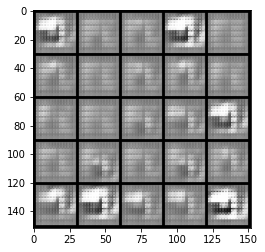

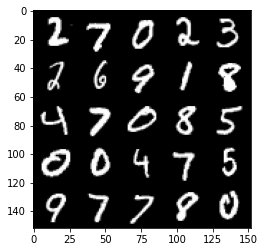

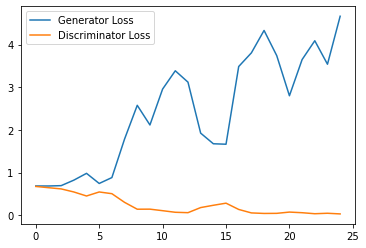

Step 1000: Generator loss: 4.472448084354401, discriminator loss: 0.05609709781780839


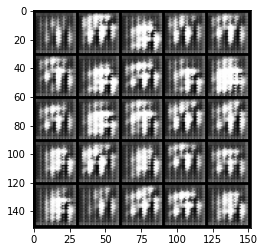

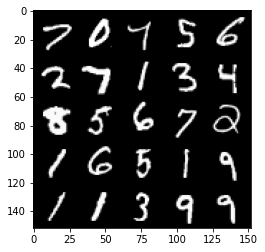

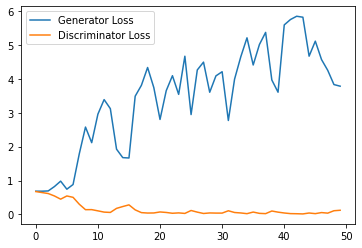

Step 1500: Generator loss: 3.9116293716430666, discriminator loss: 0.07056271502934396


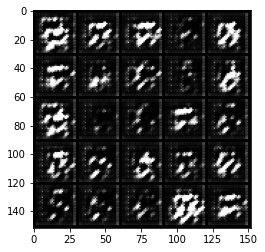

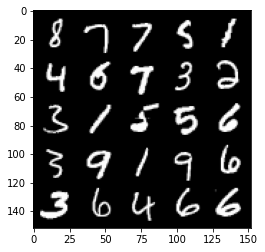

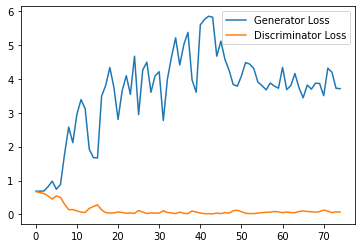

Step 2000: Generator loss: 3.130867537498474, discriminator loss: 0.16171807289868592


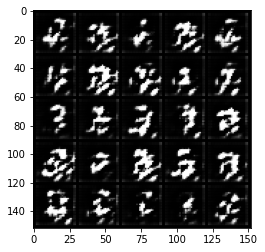

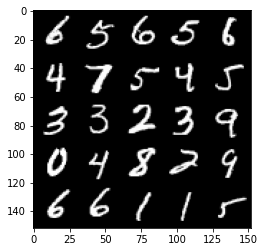

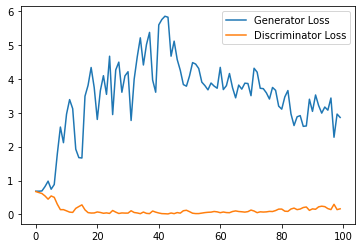

Step 2500: Generator loss: 2.5666269099712373, discriminator loss: 0.2528276450037956


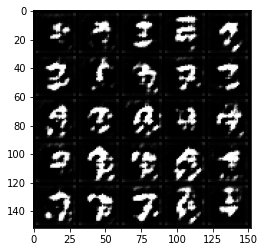

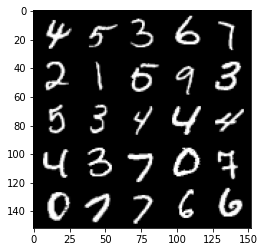

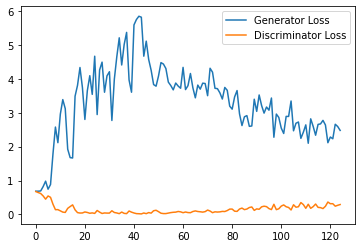

Step 3000: Generator loss: 2.362151875257492, discriminator loss: 0.2667322679162025


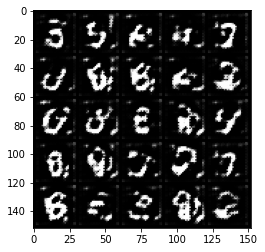

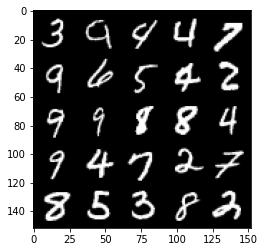

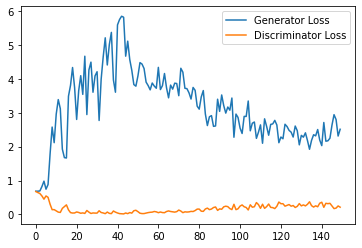

Step 3500: Generator loss: 2.3582932531833647, discriminator loss: 0.2911386463940144


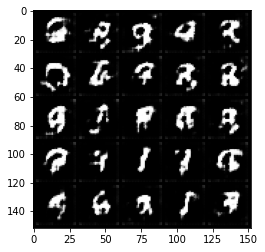

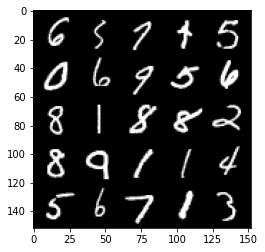

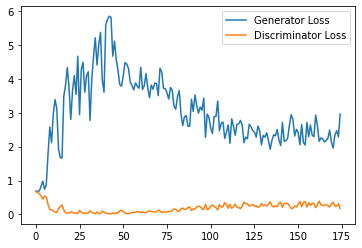

Step 4000: Generator loss: 2.417478573799133, discriminator loss: 0.2595589946657419


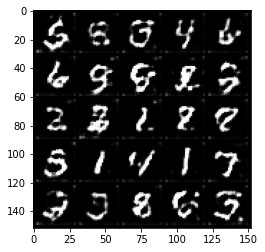

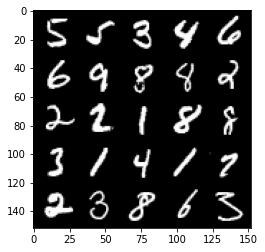

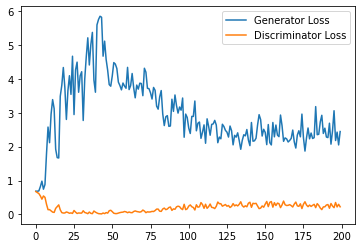

Step 4500: Generator loss: 2.216781149625778, discriminator loss: 0.3070502902567387


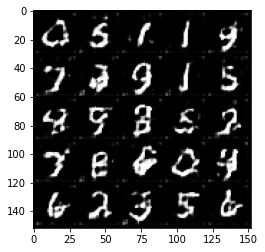

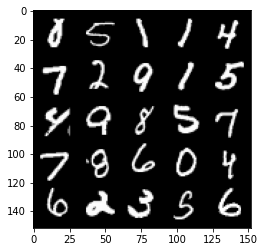

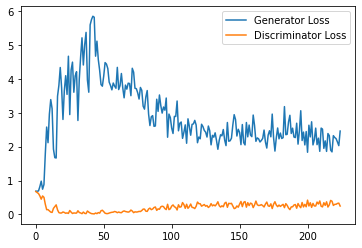

Step 5000: Generator loss: 2.042899686336517, discriminator loss: 0.33193519520759585


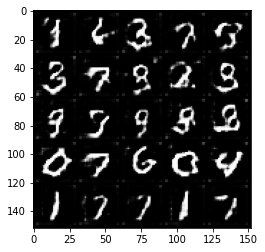

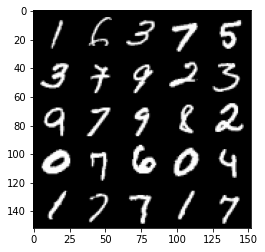

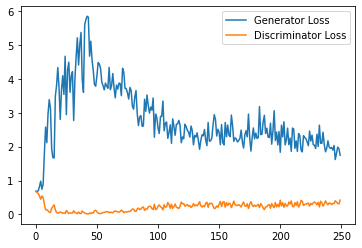

Step 5500: Generator loss: 1.9185059154033661, discriminator loss: 0.3602661534845829


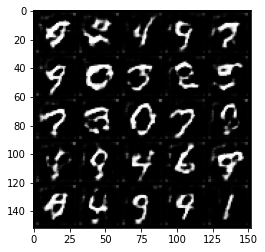

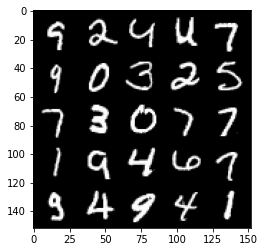

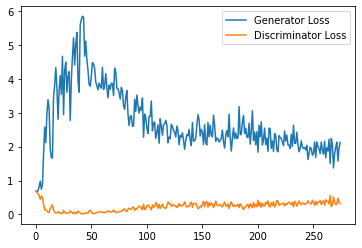

Step 6000: Generator loss: 1.750177522420883, discriminator loss: 0.3947659067809582


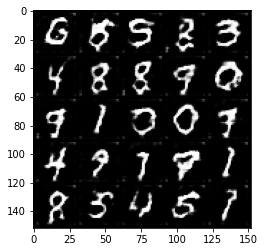

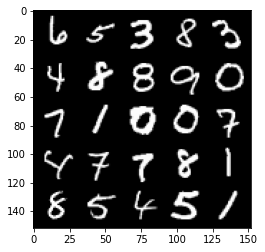

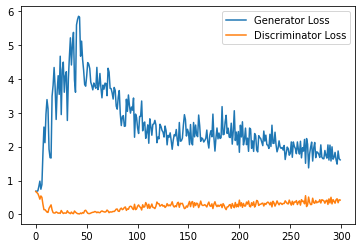

Step 6500: Generator loss: 1.6376733199357987, discriminator loss: 0.4141909435391426


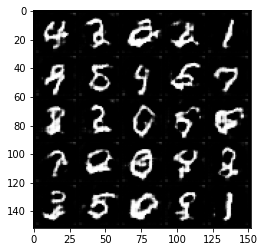

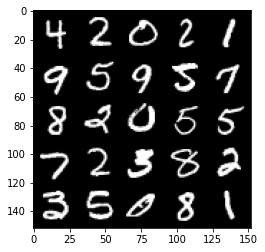

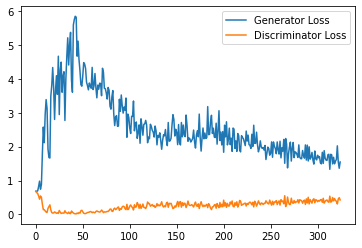

Step 7000: Generator loss: 1.6255291175842286, discriminator loss: 0.4411790604889393


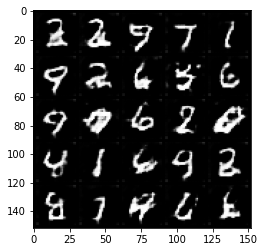

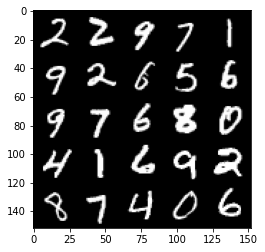

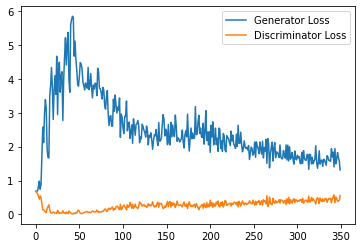

Step 7500: Generator loss: 1.4930612114667892, discriminator loss: 0.4602313193678856


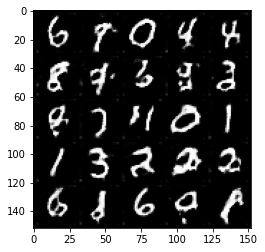

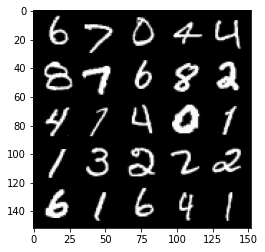

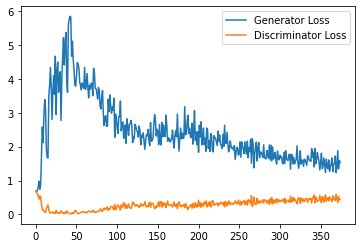

Step 8000: Generator loss: 1.4589776476621628, discriminator loss: 0.48362979882955554


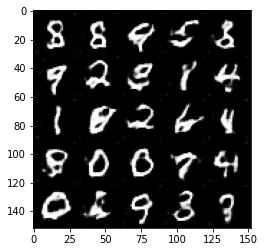

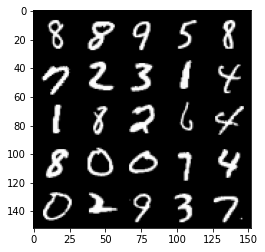

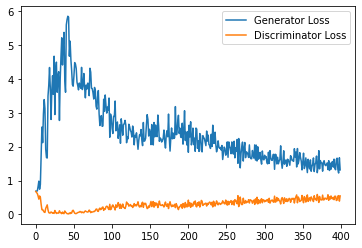

Step 8500: Generator loss: 1.3299938405752183, discriminator loss: 0.5009242350459099


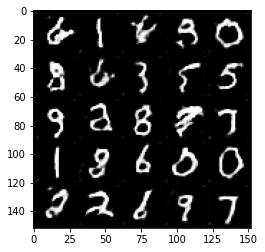

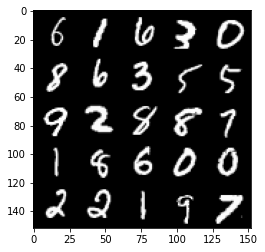

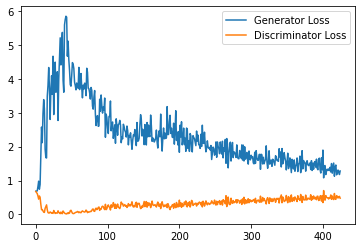

Step 9000: Generator loss: 1.290212286233902, discriminator loss: 0.5235623297691345


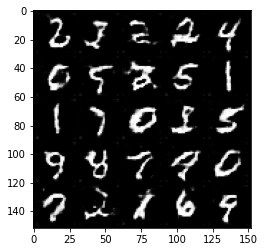

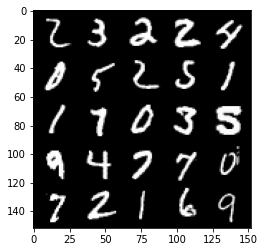

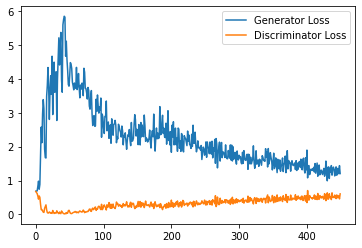

Step 9500: Generator loss: 1.303964672088623, discriminator loss: 0.5317664766907692


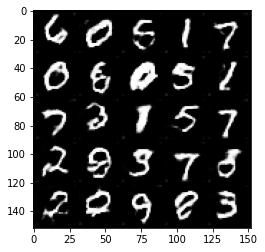

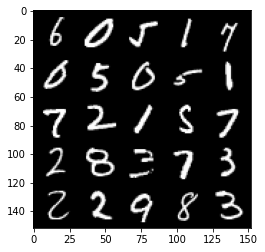

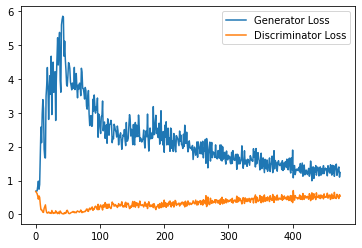

Step 10000: Generator loss: 1.223215830564499, discriminator loss: 0.5323451875448227


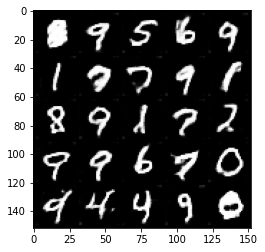

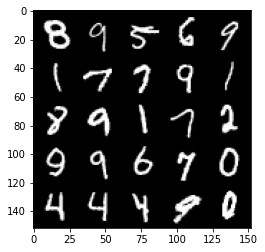

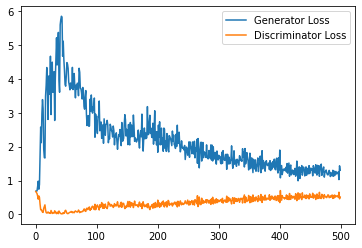

Step 10500: Generator loss: 1.2369375129938125, discriminator loss: 0.5470618094205857


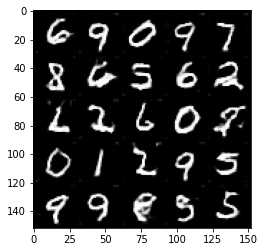

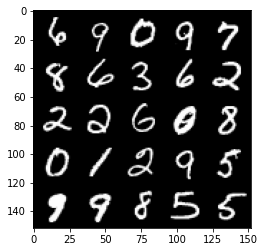

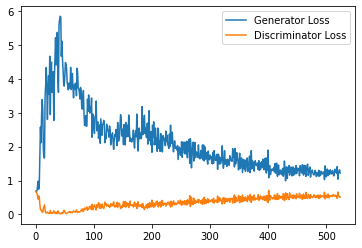

Step 11000: Generator loss: 1.1924551169872284, discriminator loss: 0.5526534465551376


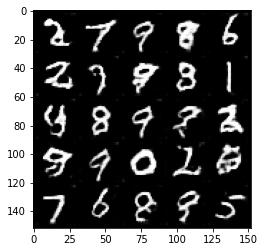

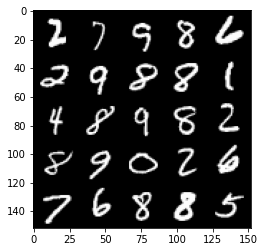

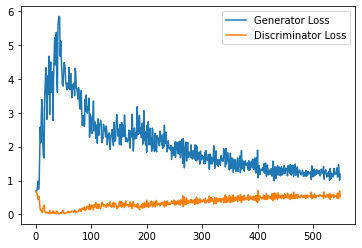

Step 11500: Generator loss: 1.155588254213333, discriminator loss: 0.5533431578874588


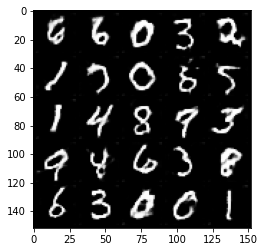

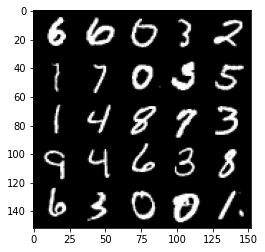

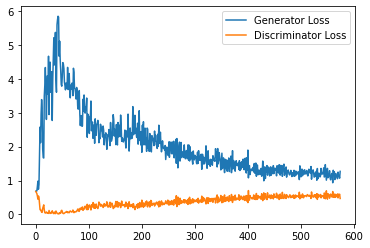

Step 12000: Generator loss: 1.2101235038042069, discriminator loss: 0.5639631468653679


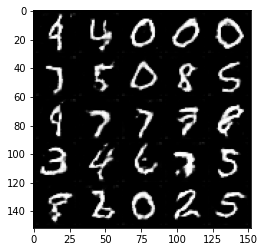

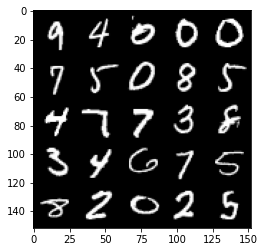

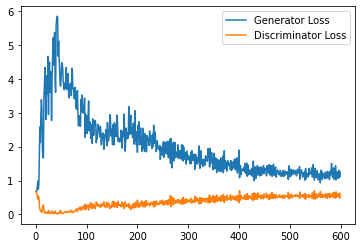

Step 12500: Generator loss: 1.1612019379138947, discriminator loss: 0.5637437444329262


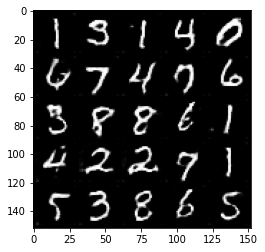

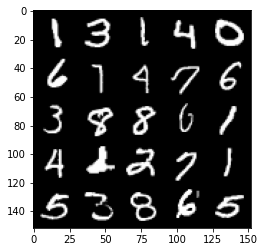

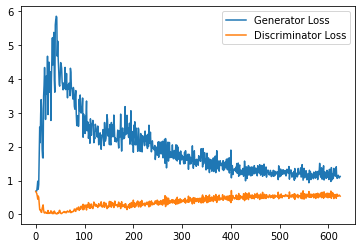

Step 13000: Generator loss: 1.118307144165039, discriminator loss: 0.5759518451690674


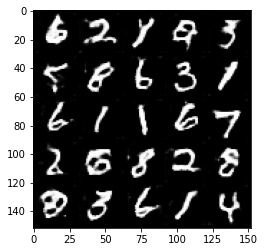

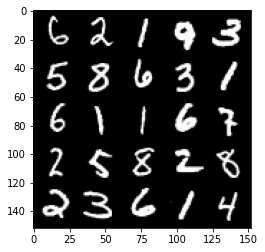

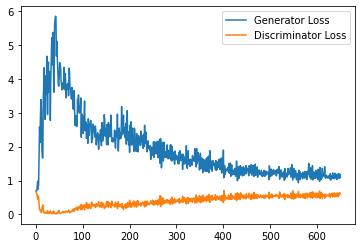

Step 13500: Generator loss: 1.1326128188371658, discriminator loss: 0.5625246669054031


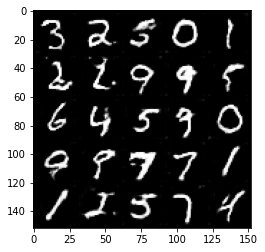

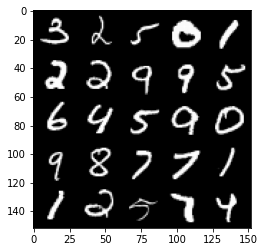

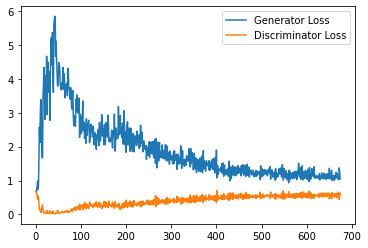

Step 14000: Generator loss: 1.1378955203294754, discriminator loss: 0.5730511581301689


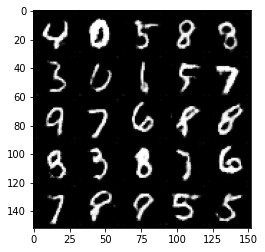

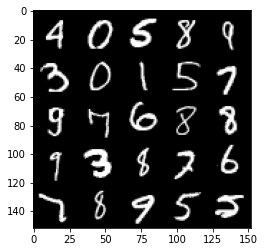

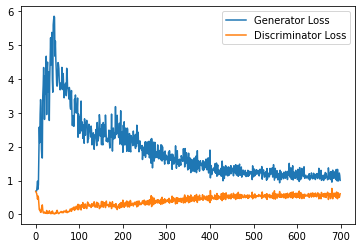

Step 14500: Generator loss: 1.065117908835411, discriminator loss: 0.5800455226898193


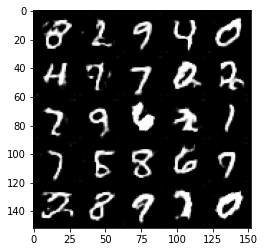

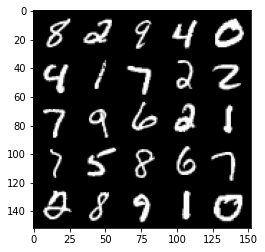

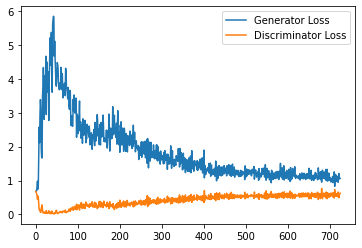

Step 15000: Generator loss: 1.117257800936699, discriminator loss: 0.5788492205142974


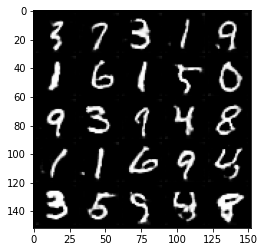

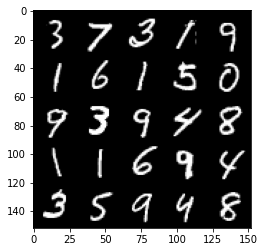

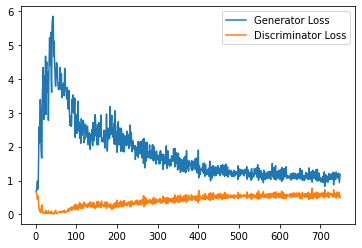

Step 15500: Generator loss: 1.0531093443632127, discriminator loss: 0.5875400733947754


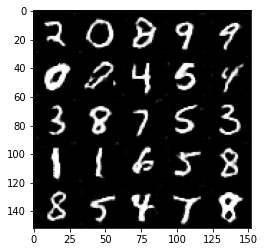

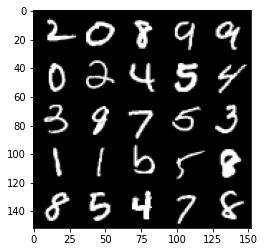

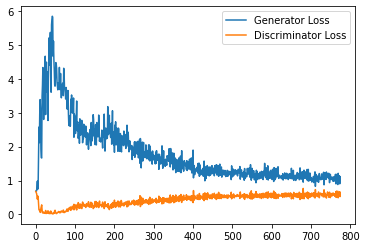

Step 16000: Generator loss: 1.056087322473526, discriminator loss: 0.5840625805258751


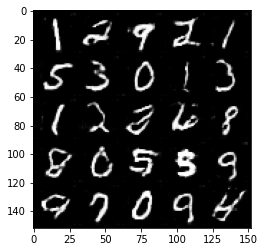

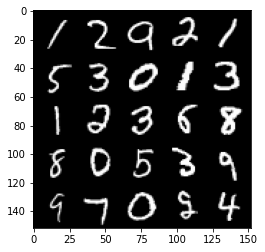

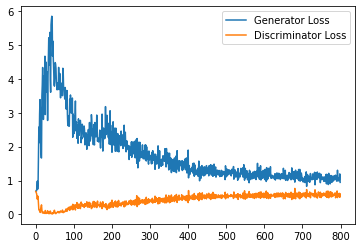

Step 16500: Generator loss: 1.0825420606136322, discriminator loss: 0.5813978595733642


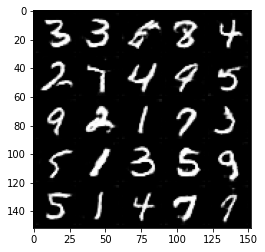

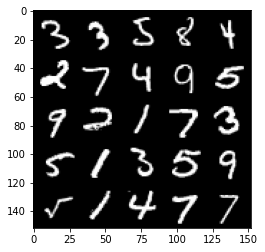

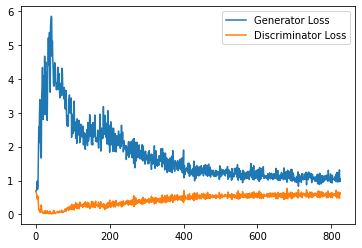

Step 17000: Generator loss: 1.0422125244140625, discriminator loss: 0.5815748594403267


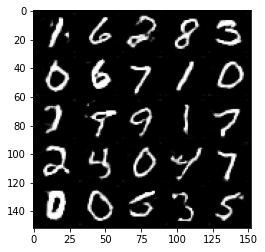

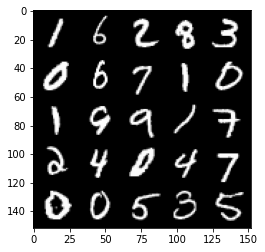

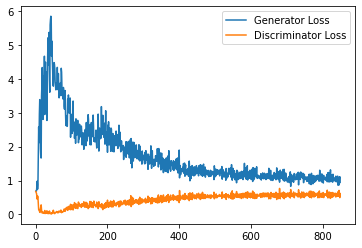

Step 17500: Generator loss: 1.0354193108081817, discriminator loss: 0.5878503410220146


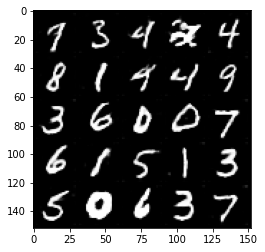

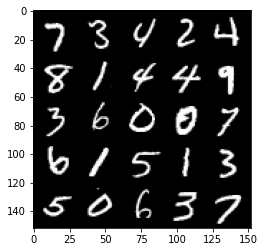

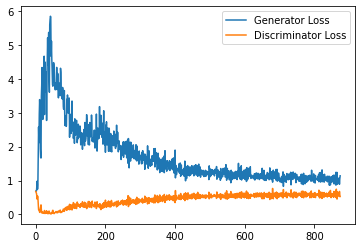

Step 18000: Generator loss: 1.039047976732254, discriminator loss: 0.5903883869051934


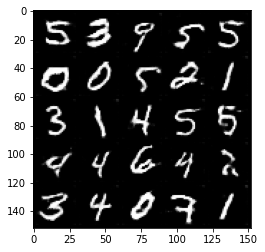

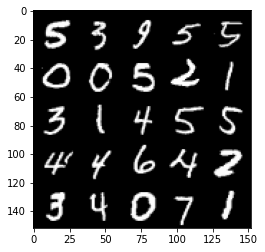

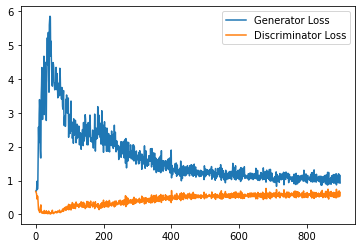

Step 18500: Generator loss: 1.0875230736732482, discriminator loss: 0.5912026604413986


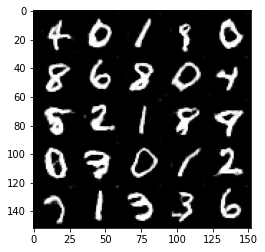

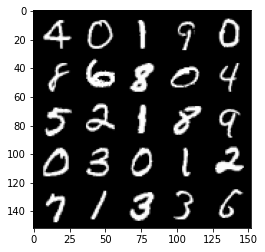

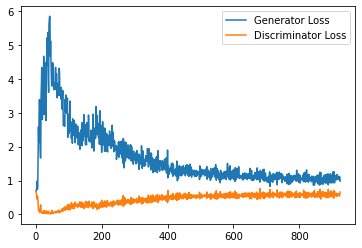

Step 19000: Generator loss: 1.0322097823619842, discriminator loss: 0.5950192101597785


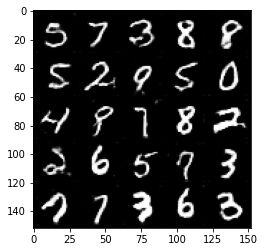

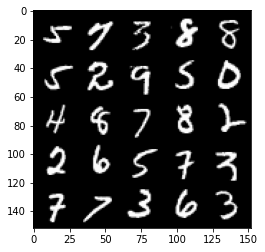

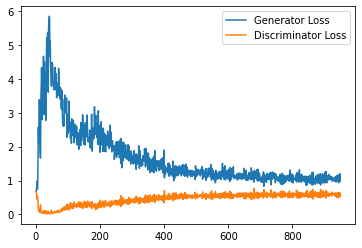

Step 19500: Generator loss: 1.006662856578827, discriminator loss: 0.594855840921402


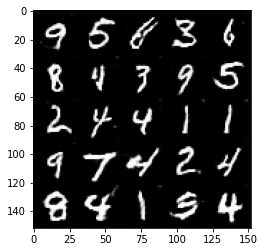

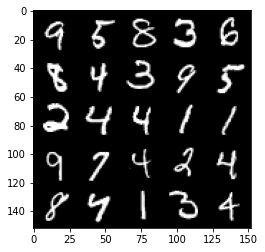

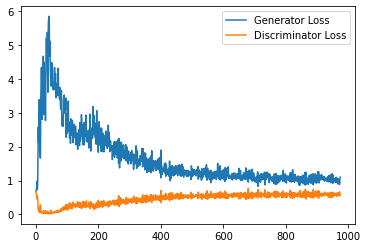

Step 20000: Generator loss: 1.0227918938398362, discriminator loss: 0.5954522089958191


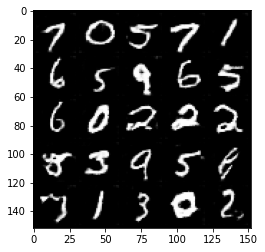

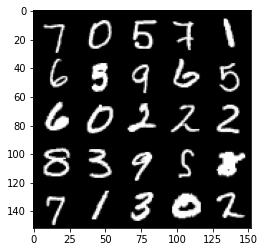

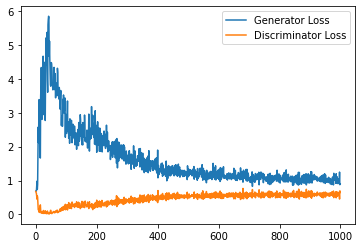

Step 20500: Generator loss: 1.0207346926927567, discriminator loss: 0.5926463230848312


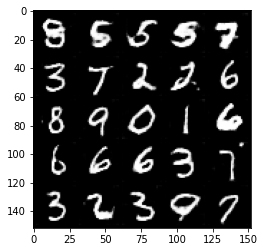

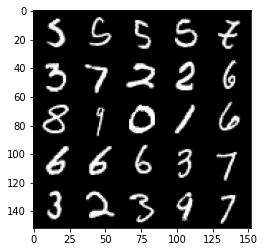

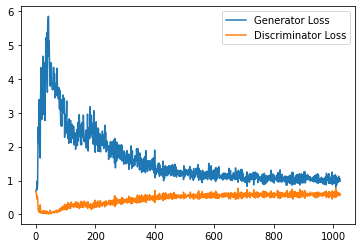

Step 21000: Generator loss: 1.035217278957367, discriminator loss: 0.6004163489937783


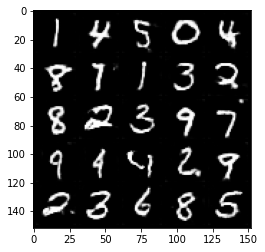

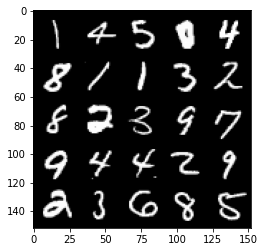

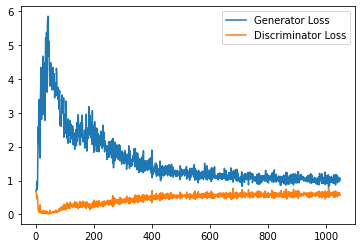

Step 21500: Generator loss: 1.0098770889043809, discriminator loss: 0.6003979315757751


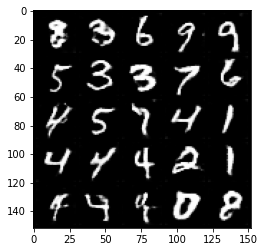

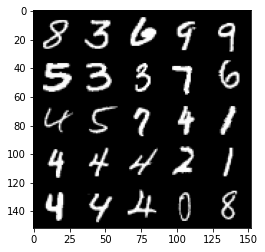

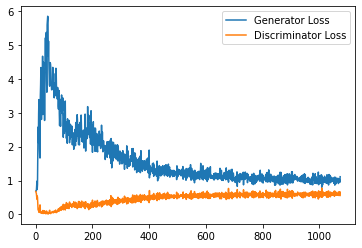

Step 22000: Generator loss: 1.0545231598615645, discriminator loss: 0.6056066623926163


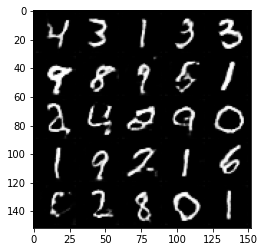

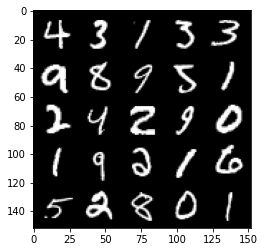

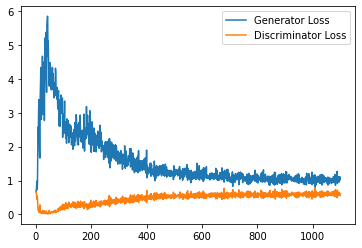

Step 22500: Generator loss: 0.9964244859218597, discriminator loss: 0.6032541190981865


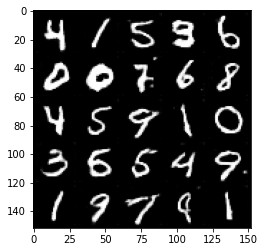

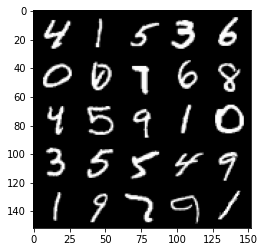

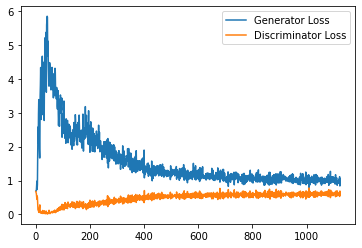

Step 23000: Generator loss: 0.9863933382034302, discriminator loss: 0.6055231179594993


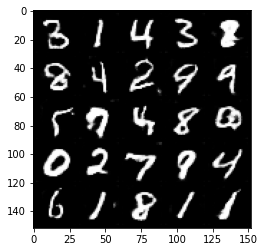

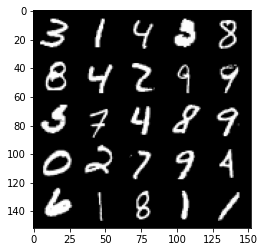

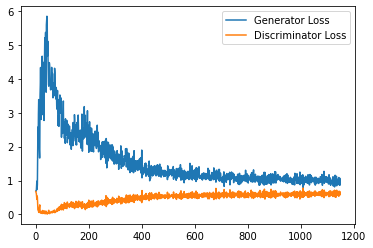

Step 23500: Generator loss: 1.0017298920154571, discriminator loss: 0.6044955170154571


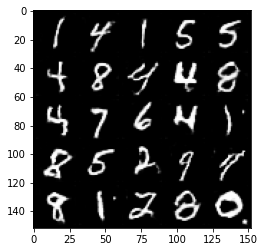

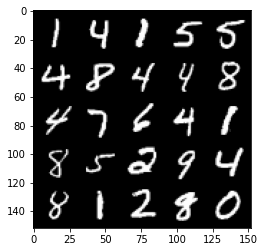

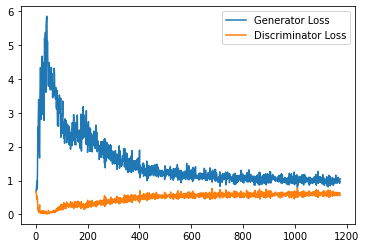

Step 24000: Generator loss: 0.9900198310613633, discriminator loss: 0.6076388185620308


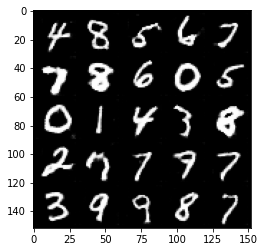

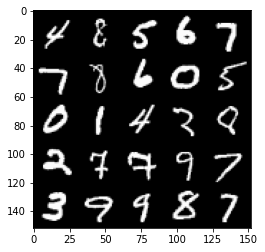

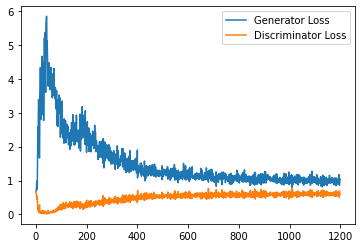

Step 24500: Generator loss: 0.9897993026971817, discriminator loss: 0.607421066582203


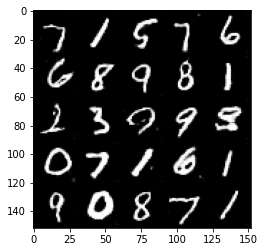

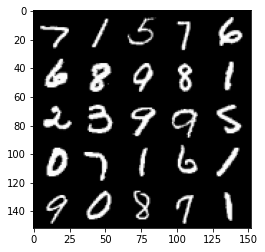

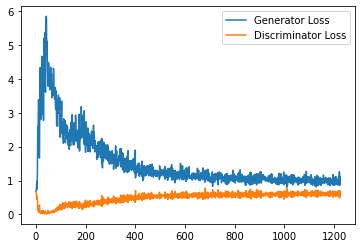

Step 25000: Generator loss: 0.9887031401395798, discriminator loss: 0.60303796595335


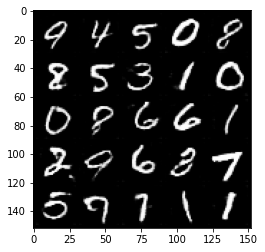

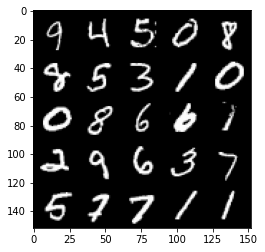

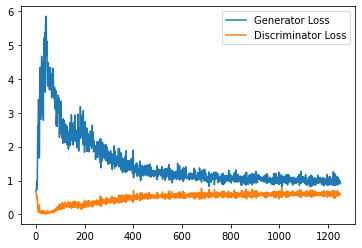

Step 25500: Generator loss: 0.9615900586843491, discriminator loss: 0.6060094792842865


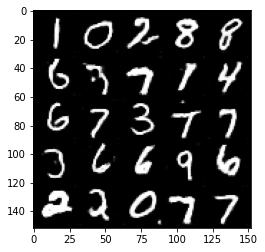

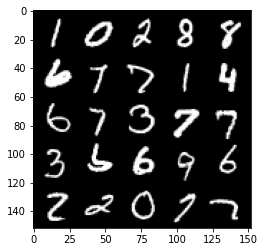

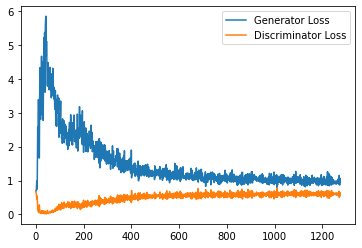

Step 26000: Generator loss: 1.0026752375364303, discriminator loss: 0.6110693874955178


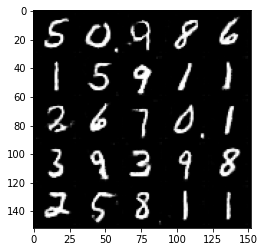

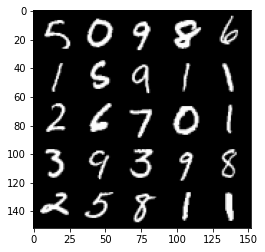

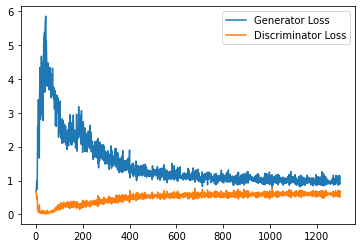

Step 26500: Generator loss: 0.99072216796875, discriminator loss: 0.6073753368258477


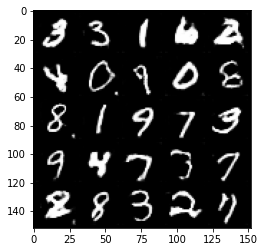

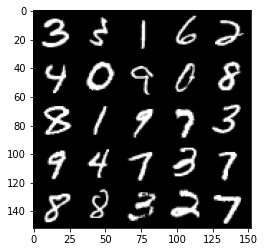

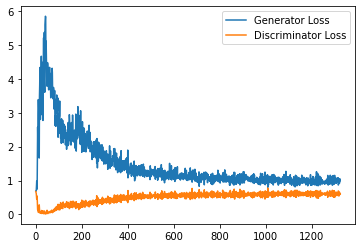

Step 27000: Generator loss: 0.9581887106895447, discriminator loss: 0.6084838156104088


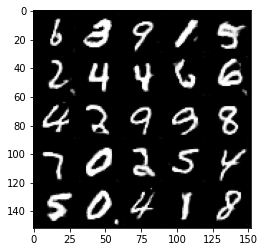

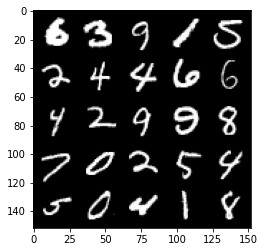

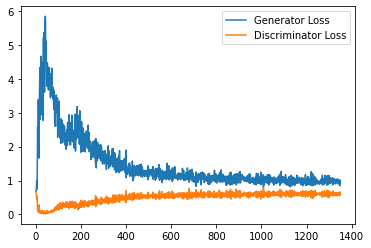

Step 27500: Generator loss: 0.9706197445392608, discriminator loss: 0.6078516923189163


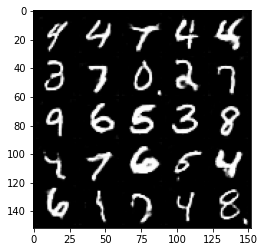

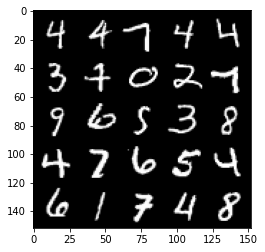

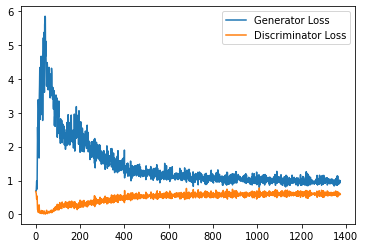

Step 28000: Generator loss: 0.976817636847496, discriminator loss: 0.6098975928425789


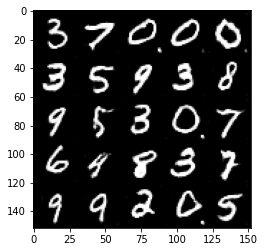

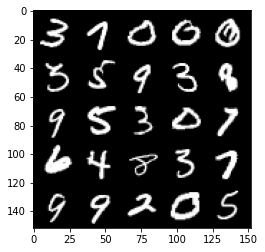

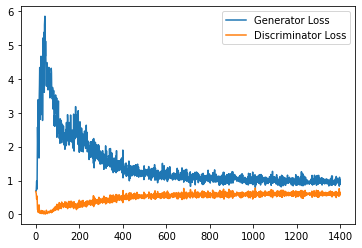

Step 28500: Generator loss: 0.9739170271158218, discriminator loss: 0.6147563492655754


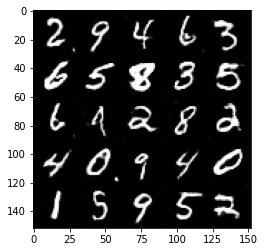

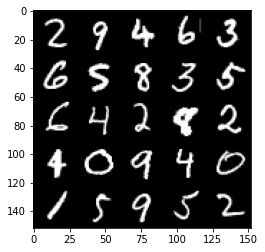

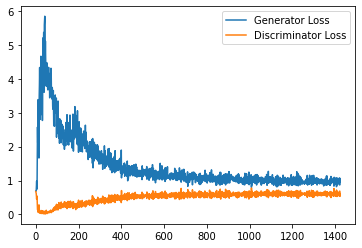

Step 29000: Generator loss: 0.9733096667528153, discriminator loss: 0.6103829349279404


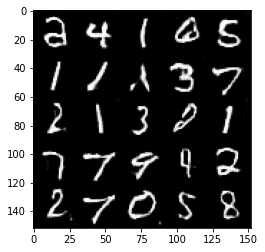

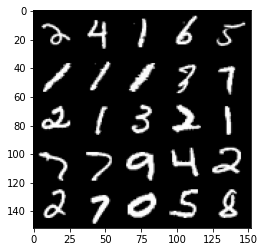

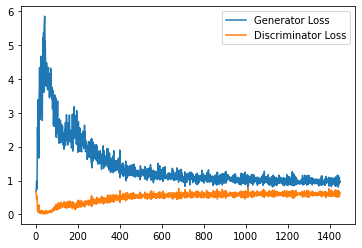

Step 29500: Generator loss: 0.9636130077838898, discriminator loss: 0.6122725822329521


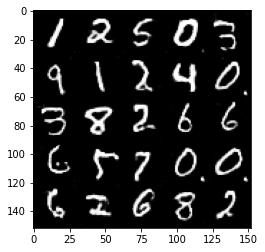

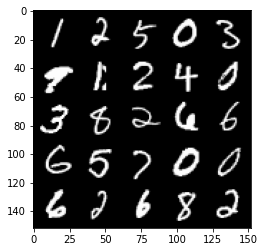

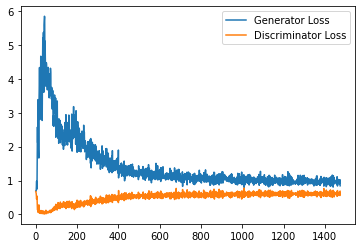

Step 30000: Generator loss: 0.9732969795465469, discriminator loss: 0.6139901623725891


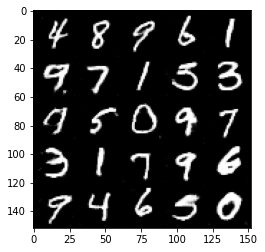

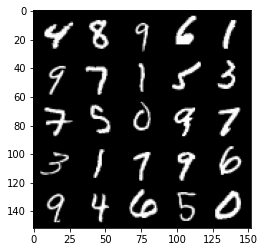

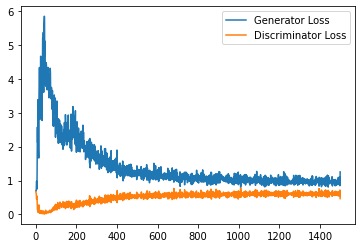

Step 30500: Generator loss: 0.9953171218633652, discriminator loss: 0.6148564990162849


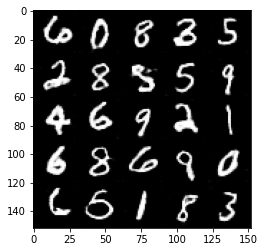

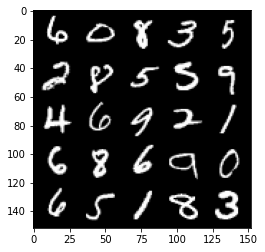

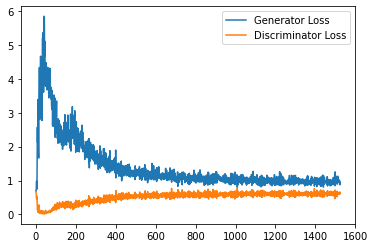

Step 31000: Generator loss: 0.9467957687377929, discriminator loss: 0.6124367006421089


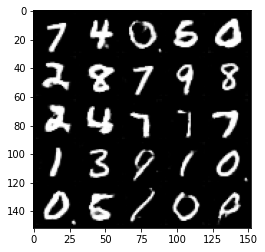

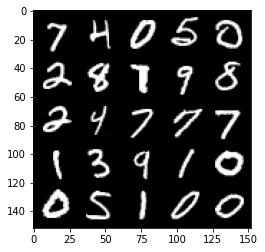

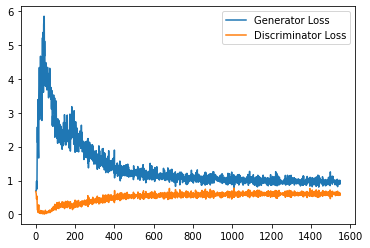

Step 31500: Generator loss: 0.9700697022676468, discriminator loss: 0.6188531039953232


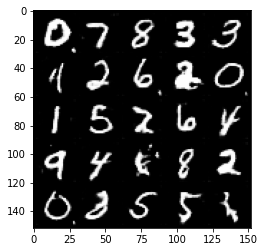

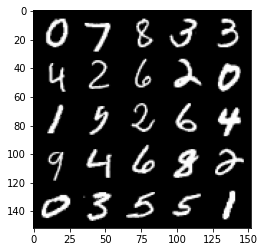

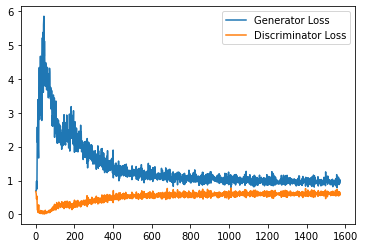

Step 32000: Generator loss: 0.9552507477998734, discriminator loss: 0.6171978290081024


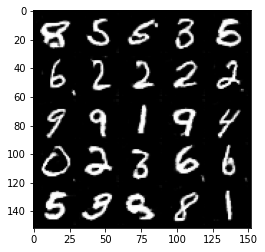

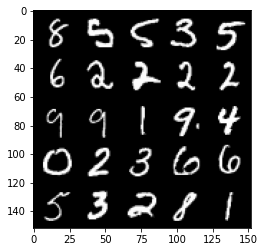

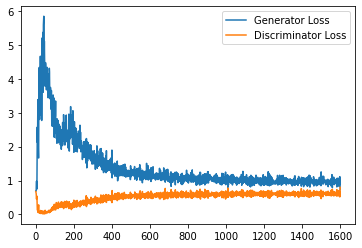

Step 32500: Generator loss: 0.973718736410141, discriminator loss: 0.6094309611320495


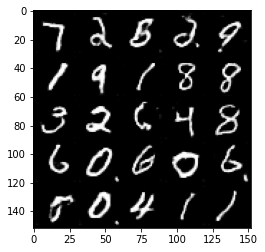

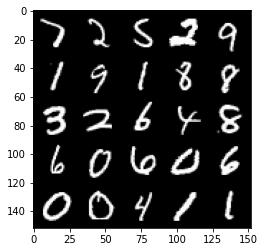

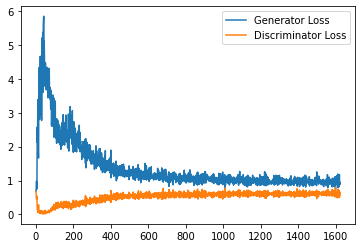

Step 33000: Generator loss: 0.9414304348230362, discriminator loss: 0.6176717764139176


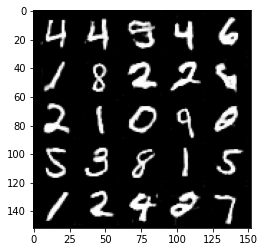

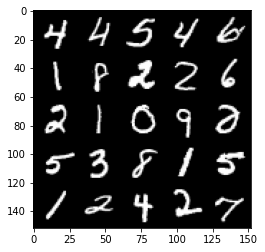

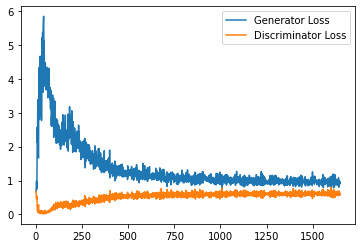

Step 33500: Generator loss: 0.9570287537574768, discriminator loss: 0.6136593746542931


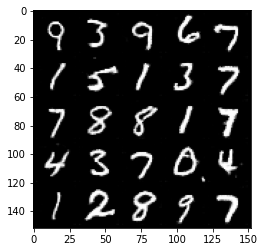

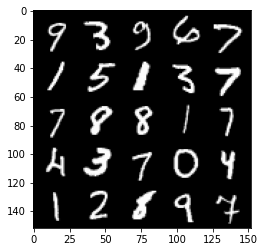

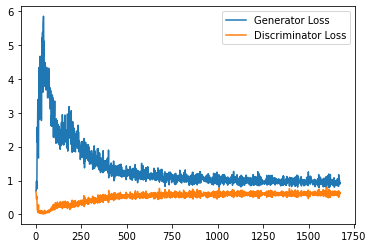

Step 34000: Generator loss: 0.9505106846094131, discriminator loss: 0.6126433866620064


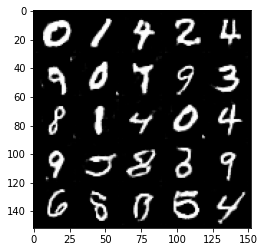

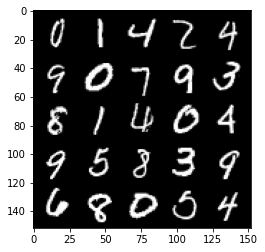

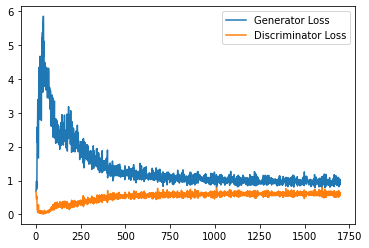

Step 34500: Generator loss: 0.9281186109781265, discriminator loss: 0.6133545393943787


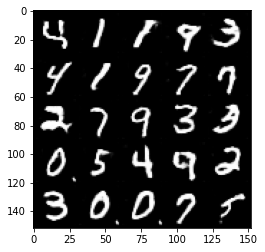

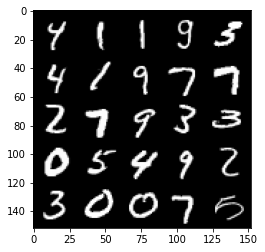

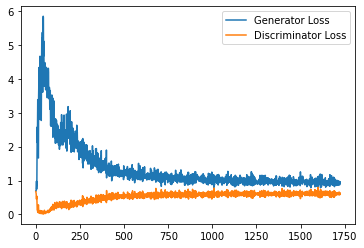

Step 35000: Generator loss: 0.9742929583787918, discriminator loss: 0.6147726986408234


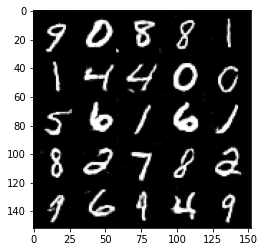

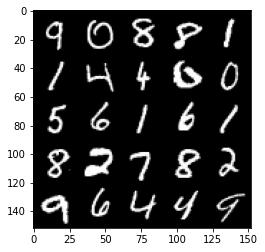

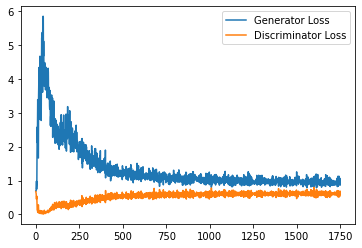

Step 35500: Generator loss: 0.9545463321208953, discriminator loss: 0.6128818028569222


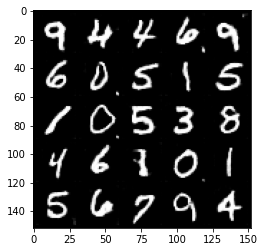

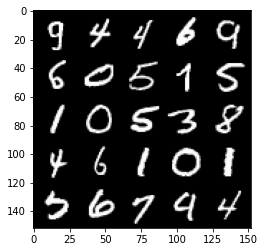

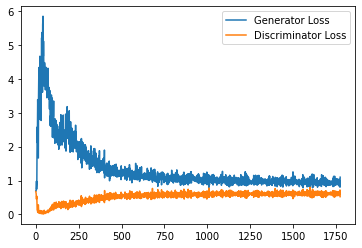

Step 36000: Generator loss: 0.9578049303293228, discriminator loss: 0.6088480319976807


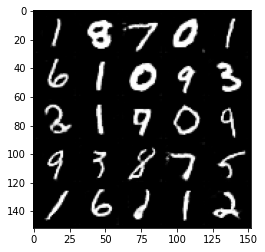

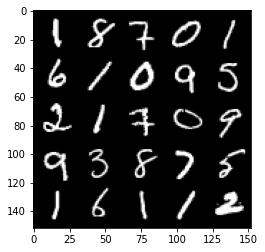

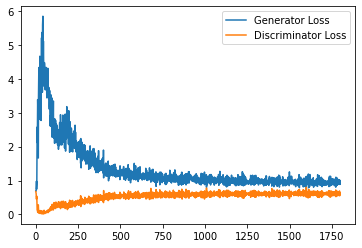

Step 36500: Generator loss: 0.9409666239023209, discriminator loss: 0.6153517803549766


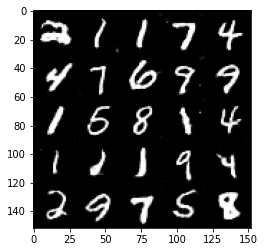

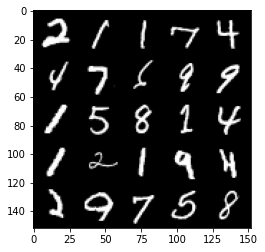

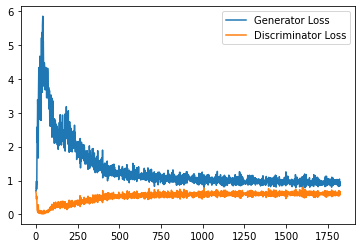

Step 37000: Generator loss: 0.9442332031726837, discriminator loss: 0.6136634806394577


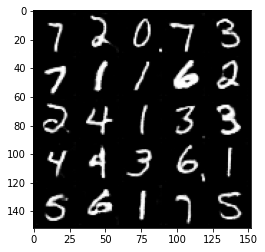

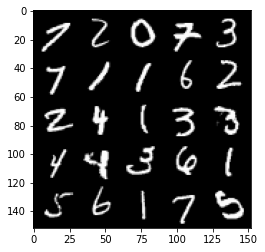

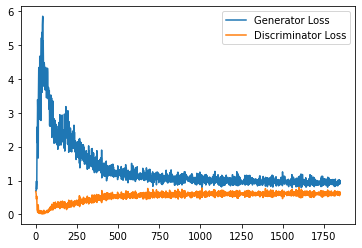

Step 37500: Generator loss: 0.9484922926425934, discriminator loss: 0.6109464147686958


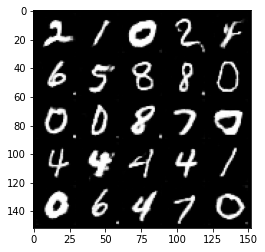

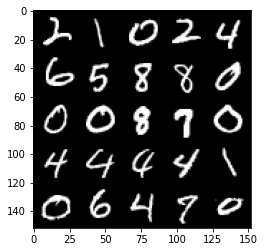

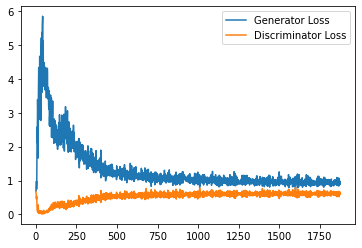

Step 38000: Generator loss: 0.930528346657753, discriminator loss: 0.6149095367789269


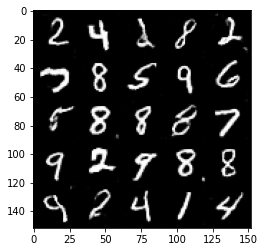

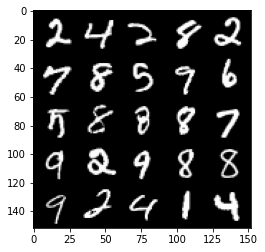

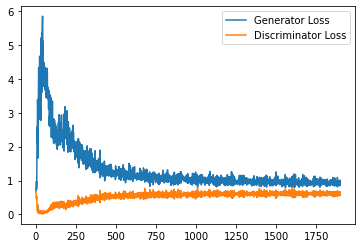

Step 38500: Generator loss: 0.9526486809253693, discriminator loss: 0.6099366369843483


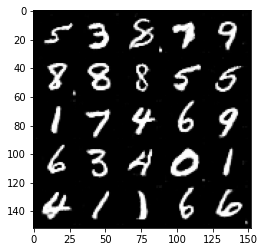

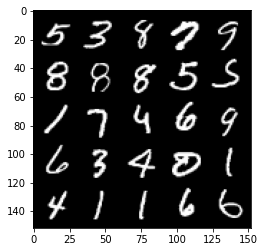

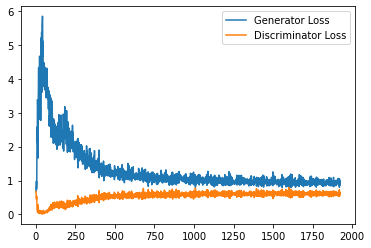

Step 39000: Generator loss: 0.9577172313928604, discriminator loss: 0.6062978020310402


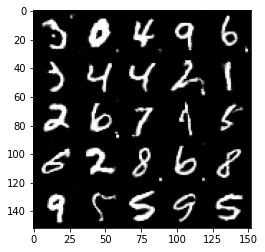

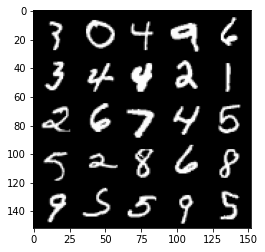

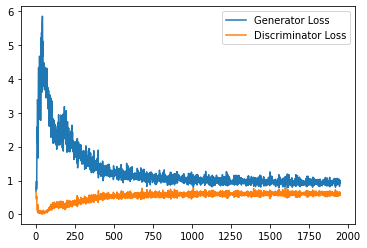

Step 39500: Generator loss: 0.9836602753400803, discriminator loss: 0.6108020409345627


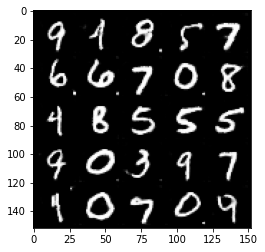

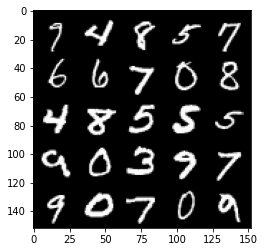

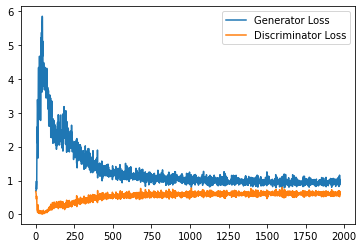

Step 40000: Generator loss: 0.9500396183729172, discriminator loss: 0.6072260813117027


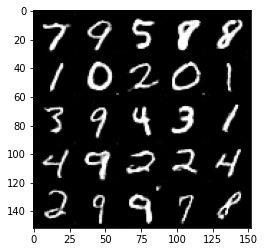

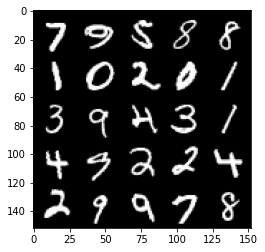

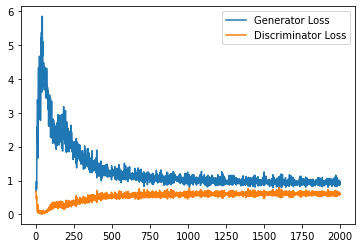

Step 40500: Generator loss: 0.9502510960102082, discriminator loss: 0.6094270316362381


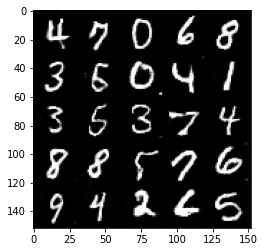

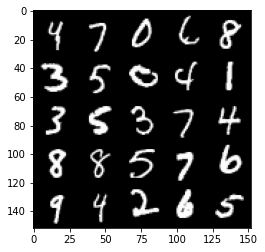

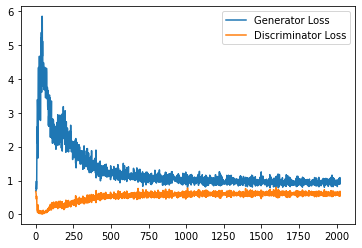

Step 41000: Generator loss: 0.965663460969925, discriminator loss: 0.6001443473696708


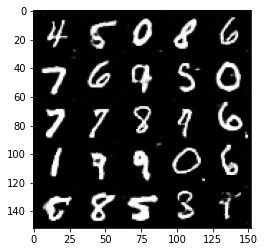

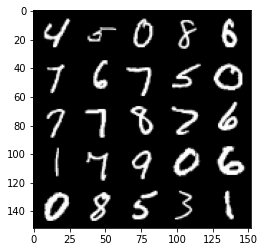

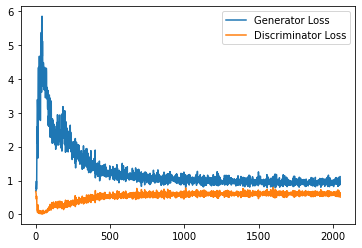

Step 41500: Generator loss: 0.9625832997560501, discriminator loss: 0.6106042472720146


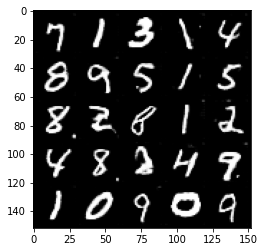

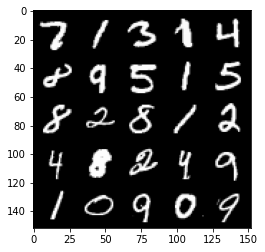

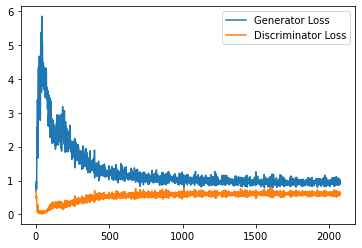

Step 42000: Generator loss: 0.962115194439888, discriminator loss: 0.6084191956520081


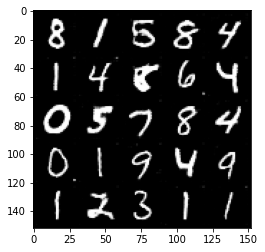

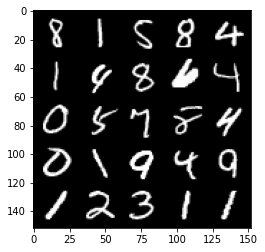

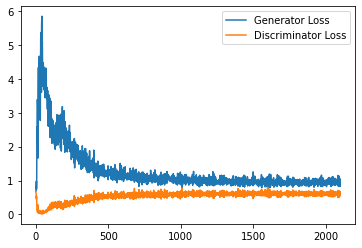

Step 42500: Generator loss: 0.9521605517864228, discriminator loss: 0.60460172021389


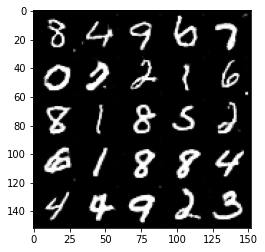

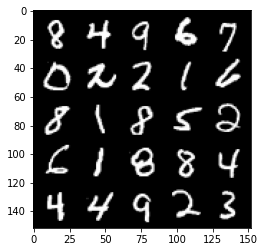

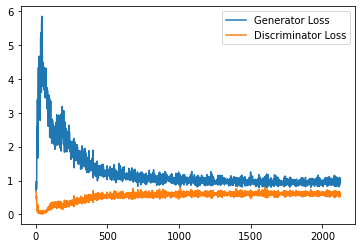

Step 43000: Generator loss: 0.9642368916273117, discriminator loss: 0.6007230450510979


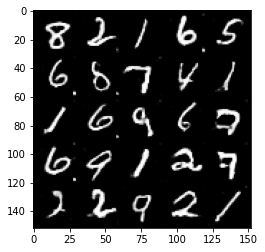

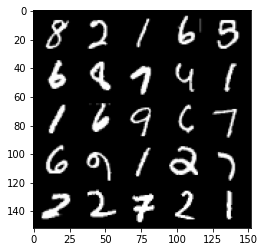

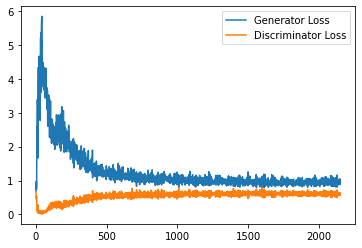

Step 43500: Generator loss: 0.9567835770845413, discriminator loss: 0.5975074187517166


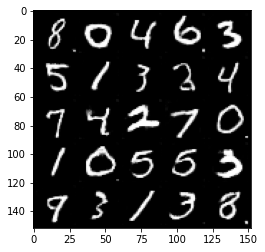

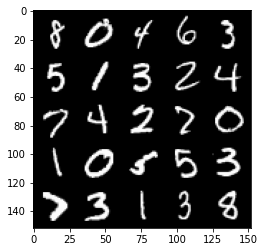

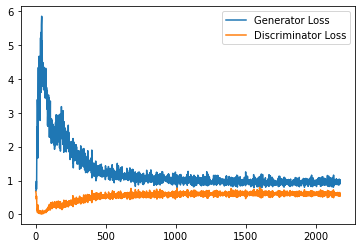

Step 44000: Generator loss: 0.9791184039115906, discriminator loss: 0.6056622114181519


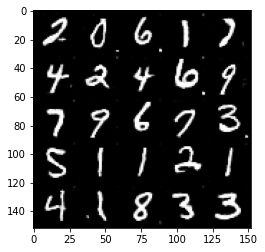

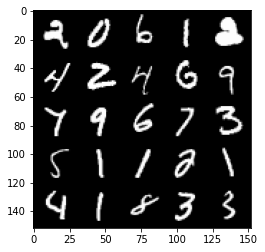

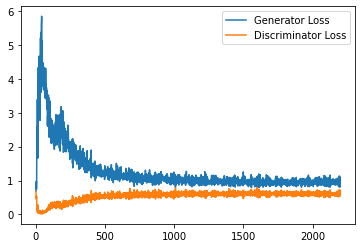

Step 44500: Generator loss: 0.9885289721488952, discriminator loss: 0.5993880546092987


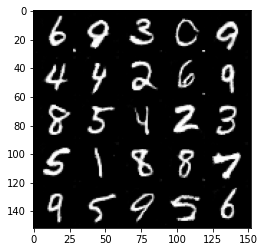

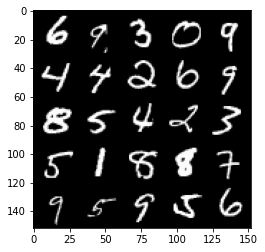

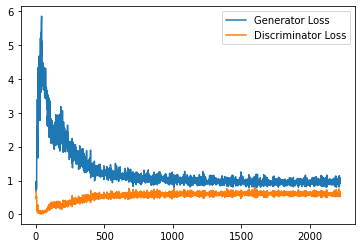

Step 45000: Generator loss: 0.9834543346166611, discriminator loss: 0.5975166035890579


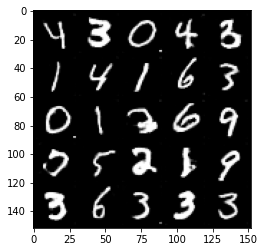

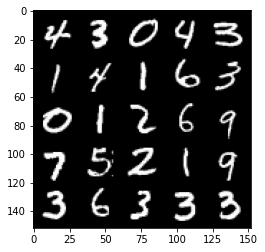

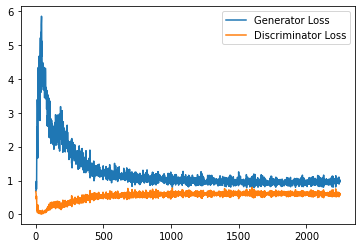

Step 45500: Generator loss: 0.9635615344047547, discriminator loss: 0.6002034032344818


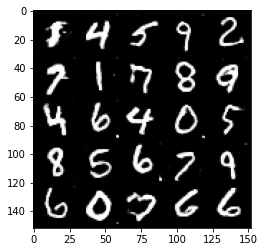

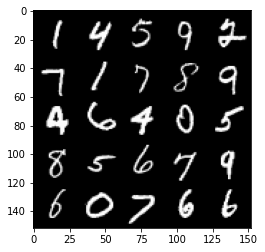

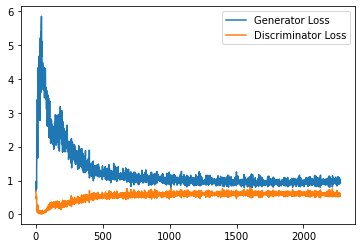

Step 46000: Generator loss: 0.9715079702138901, discriminator loss: 0.6002338985800744


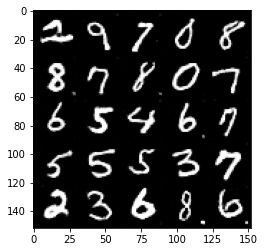

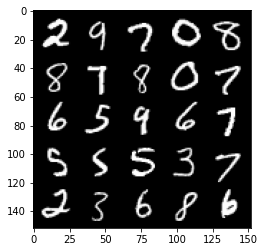

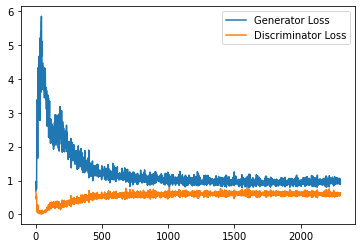

Step 46500: Generator loss: 0.9811820209026336, discriminator loss: 0.5930456657409668


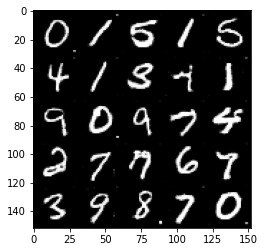

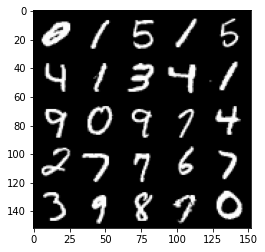

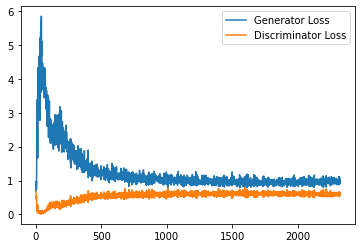

Step 47000: Generator loss: 0.9870404924154281, discriminator loss: 0.5982656710743904


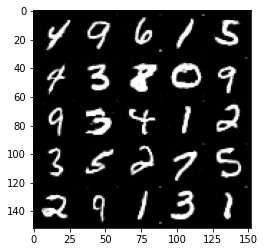

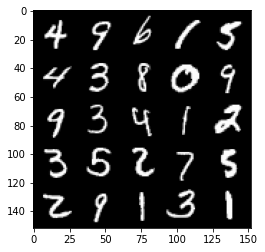

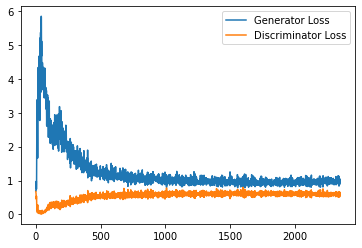

Step 47500: Generator loss: 0.9867206778526306, discriminator loss: 0.5926380282044411


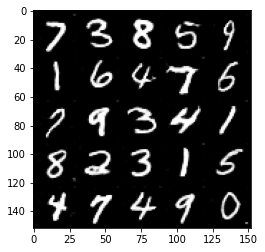

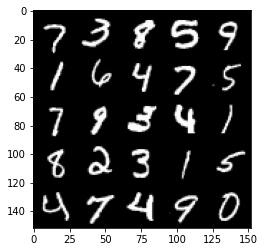

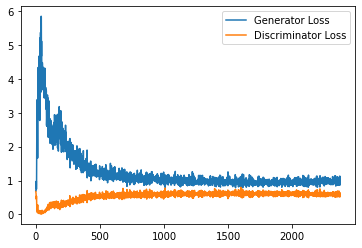

Step 48000: Generator loss: 0.9675747050046921, discriminator loss: 0.5954710199832917


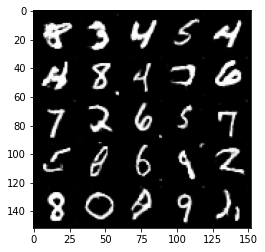

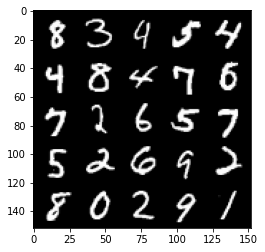

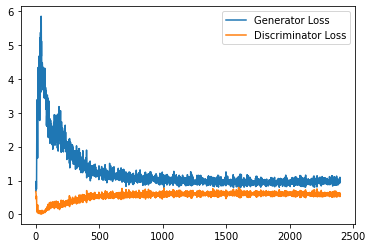

Step 48500: Generator loss: 0.9918600540161133, discriminator loss: 0.5946503071784973


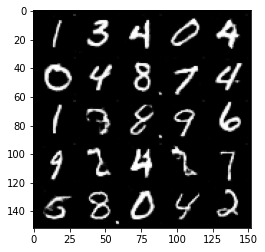

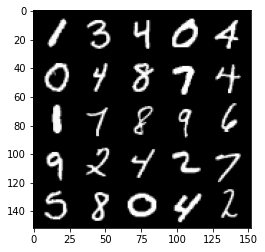

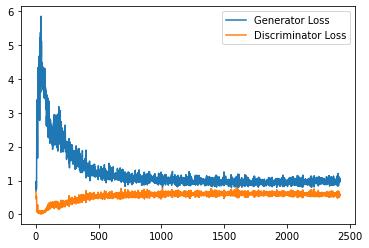

Step 49000: Generator loss: 0.9687319673299789, discriminator loss: 0.5931379101872444


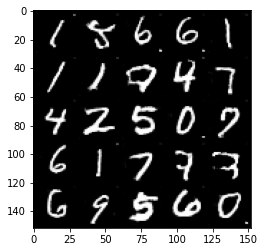

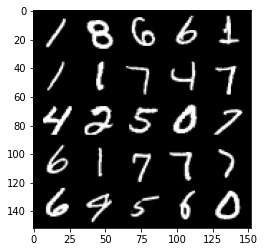

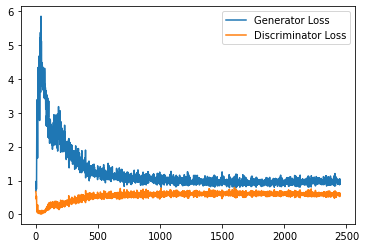

Step 49500: Generator loss: 0.9860292928218841, discriminator loss: 0.5900210244655609


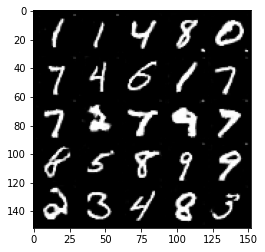

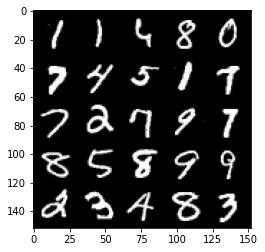

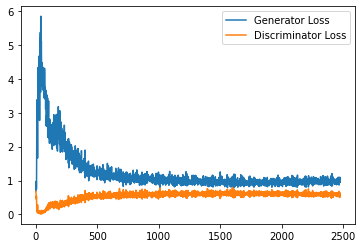

Step 50000: Generator loss: 0.9961036900281907, discriminator loss: 0.5903033779263497


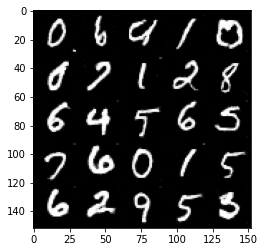

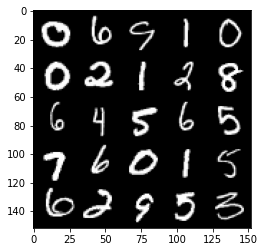

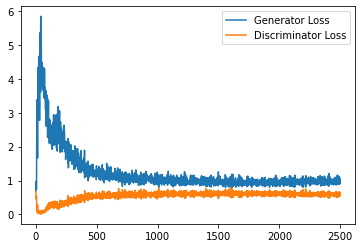

Step 50500: Generator loss: 1.0018222457170487, discriminator loss: 0.595090705215931


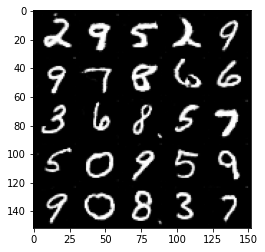

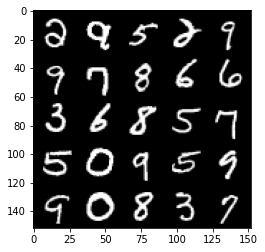

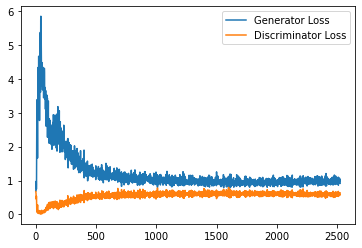

Step 51000: Generator loss: 0.9885870895385742, discriminator loss: 0.5864582494497299


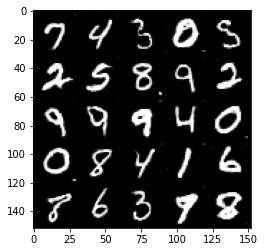

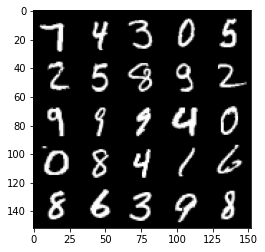

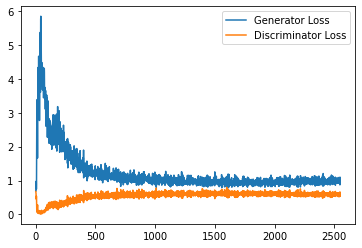

Step 51500: Generator loss: 1.0106836334466933, discriminator loss: 0.5880906660556793


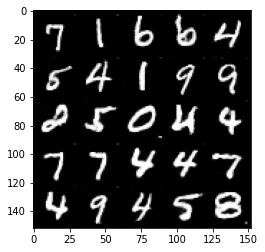

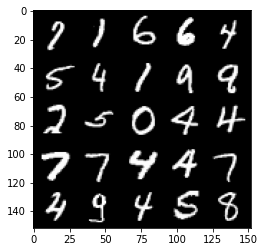

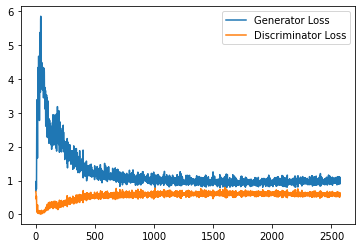

Step 52000: Generator loss: 0.9978938589096069, discriminator loss: 0.5920338866710663


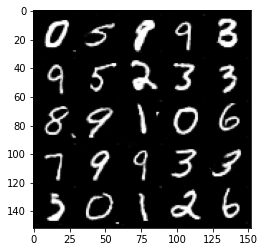

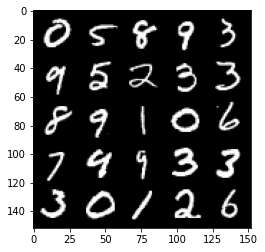

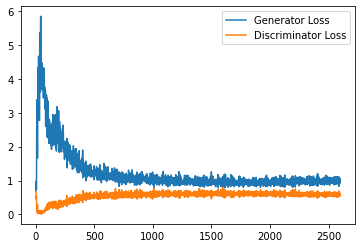

Step 52500: Generator loss: 0.9826157875061036, discriminator loss: 0.5876246556639672


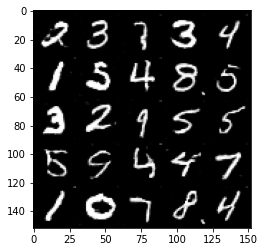

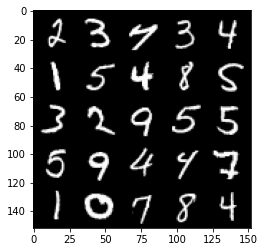

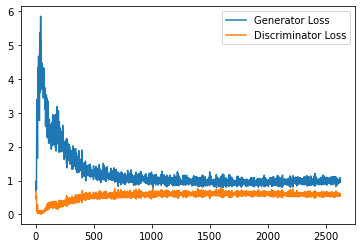

Step 53000: Generator loss: 1.001171724677086, discriminator loss: 0.5868516238331795


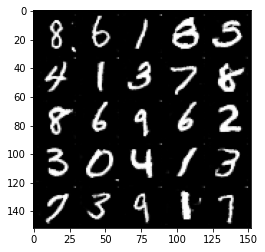

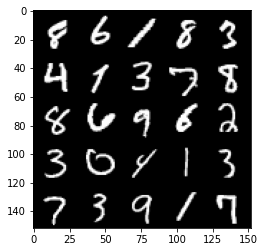

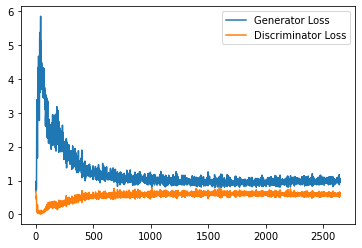

Step 53500: Generator loss: 1.0144233256578445, discriminator loss: 0.583547173678875


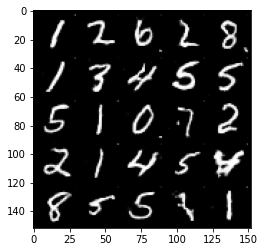

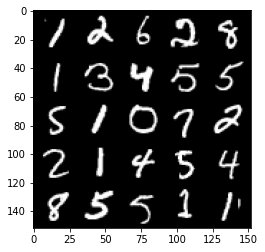

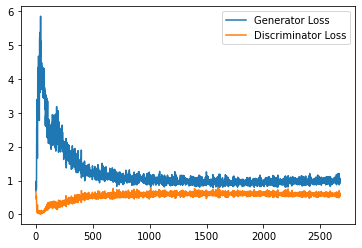

Step 54000: Generator loss: 0.9870567957162857, discriminator loss: 0.5830392869710922


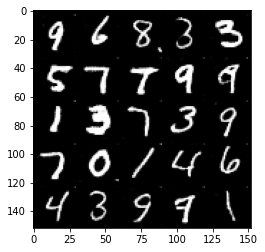

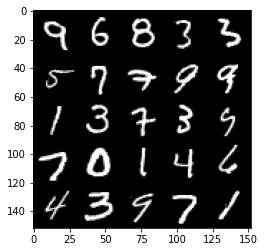

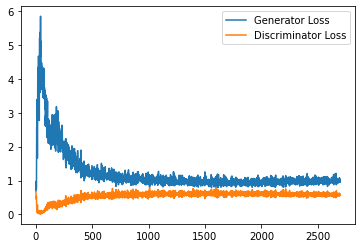

Step 54500: Generator loss: 1.0081501795053482, discriminator loss: 0.5824083661437035


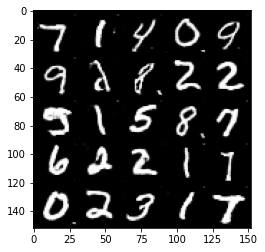

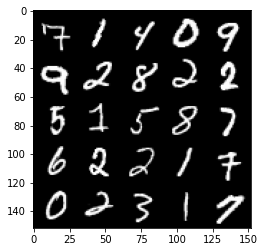

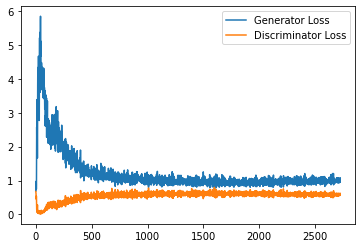

Step 55000: Generator loss: 1.0246475112438203, discriminator loss: 0.5824832606315613


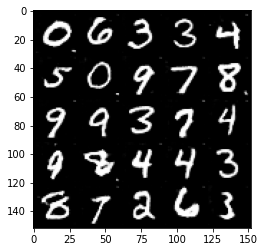

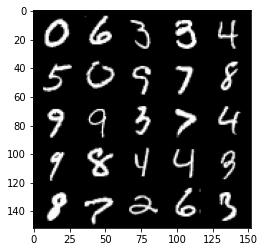

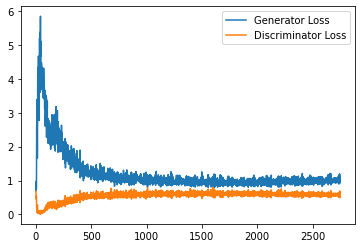

Step 55500: Generator loss: 1.0080498288869857, discriminator loss: 0.5843250907659531


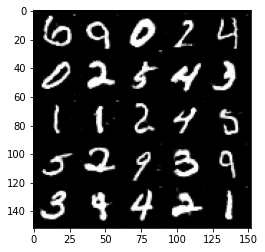

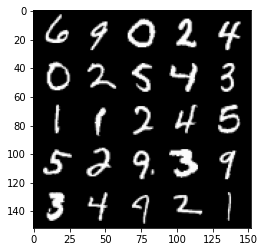

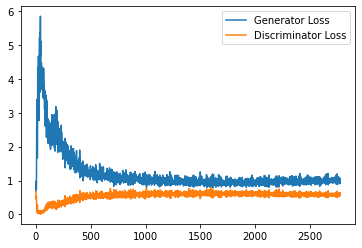

Step 56000: Generator loss: 1.0056620432138443, discriminator loss: 0.5806592032313347


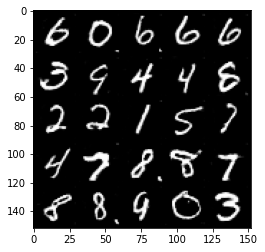

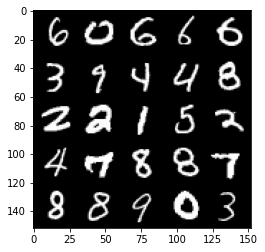

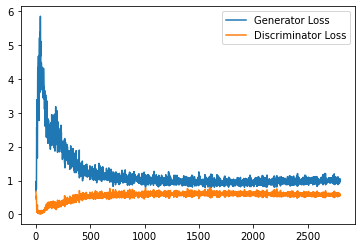

Step 56500: Generator loss: 1.0134164714813232, discriminator loss: 0.5790636277198792


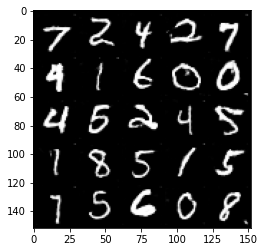

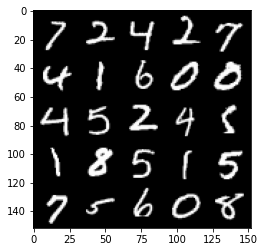

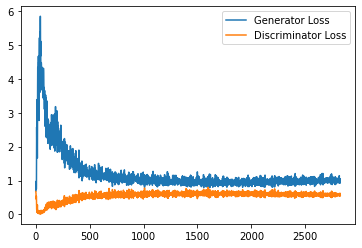

Step 57000: Generator loss: 1.0112052224874497, discriminator loss: 0.579198184967041


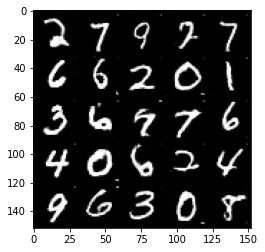

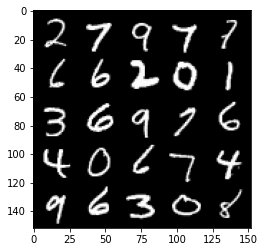

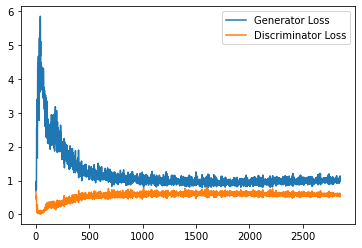

Step 57500: Generator loss: 1.02046251142025, discriminator loss: 0.5823088032603264


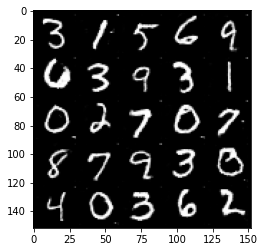

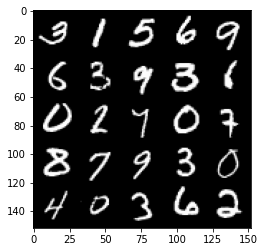

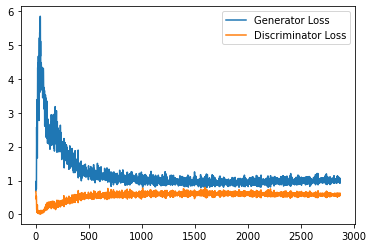

Step 58000: Generator loss: 1.0212154780626297, discriminator loss: 0.576292365193367


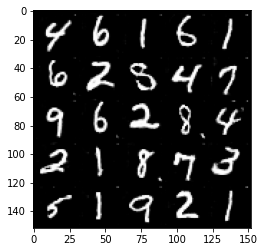

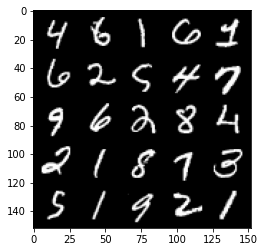

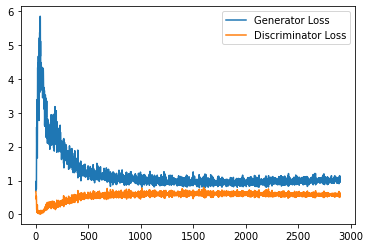

Step 58500: Generator loss: 1.0200554330348968, discriminator loss: 0.5787902656197548


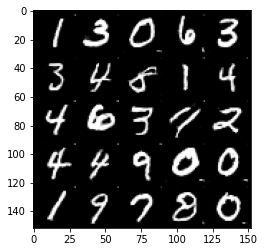

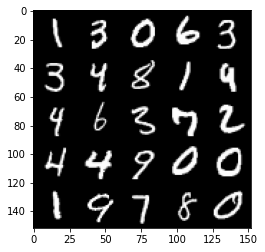

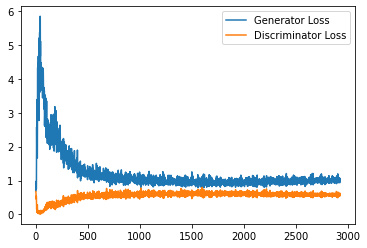

Step 59000: Generator loss: 1.037640161037445, discriminator loss: 0.5778163043856621


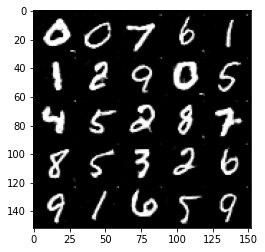

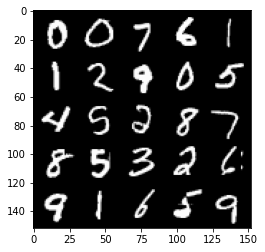

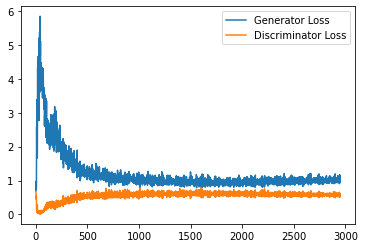

Step 59500: Generator loss: 1.0414041575193405, discriminator loss: 0.5774629601836204


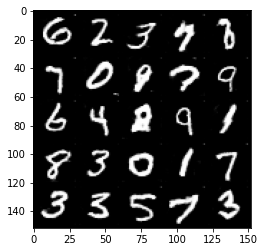

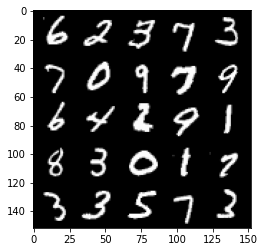

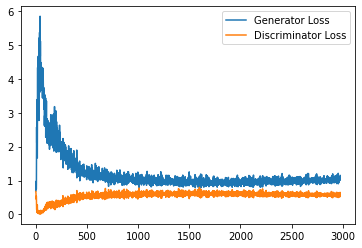

Step 60000: Generator loss: 1.0172725985050202, discriminator loss: 0.5798239740133285


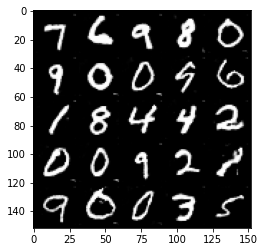

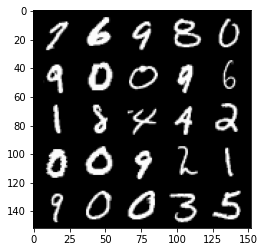

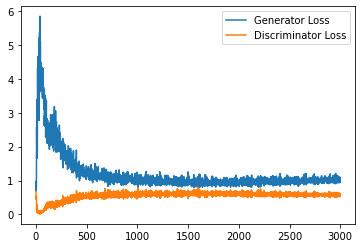

Step 60500: Generator loss: 1.028234806060791, discriminator loss: 0.5756608988046646


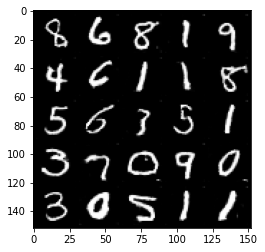

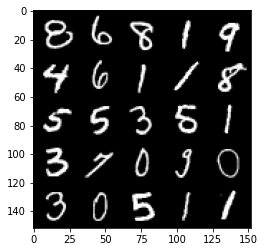

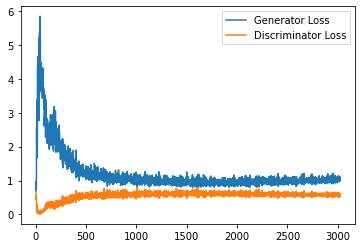

Step 61000: Generator loss: 1.029179309606552, discriminator loss: 0.5765085902810096


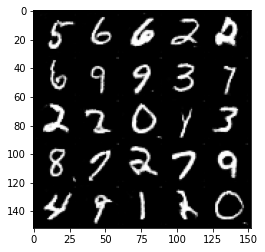

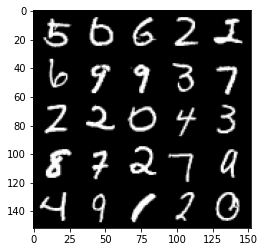

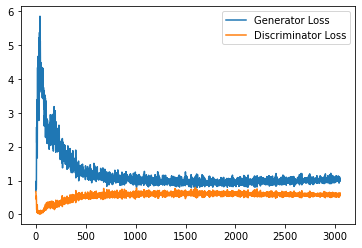

Step 61500: Generator loss: 1.060780233025551, discriminator loss: 0.5735257330536843


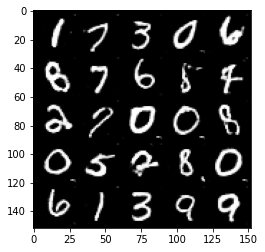

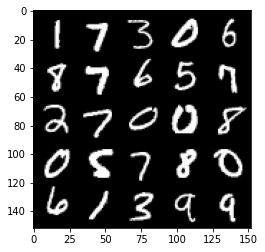

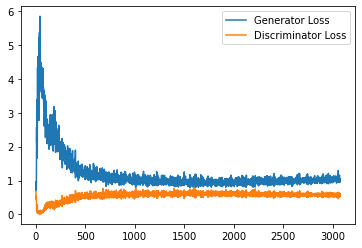

Step 62000: Generator loss: 1.0142034446001054, discriminator loss: 0.5719833573102951


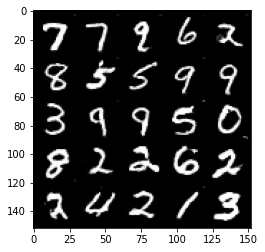

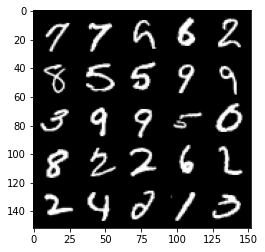

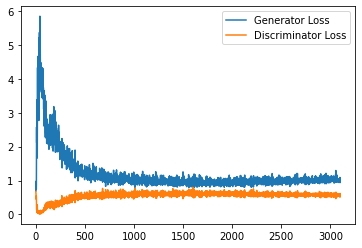

Step 62500: Generator loss: 1.042271751642227, discriminator loss: 0.5709543775916099


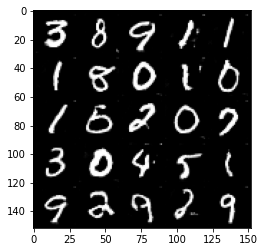

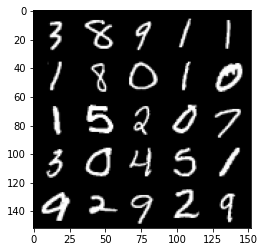

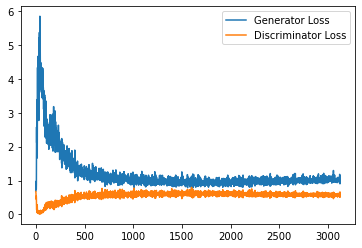

Step 63000: Generator loss: 1.0404274833202363, discriminator loss: 0.5728896664977073


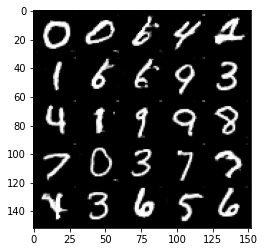

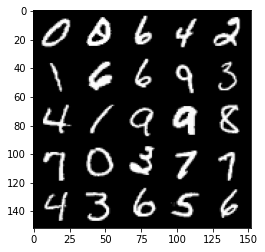

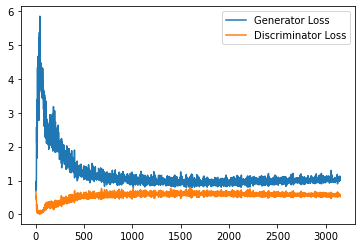

Step 63500: Generator loss: 1.0311869220733643, discriminator loss: 0.5699015366435051


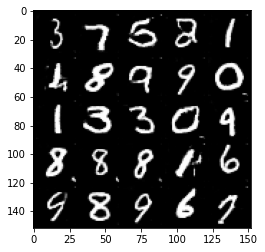

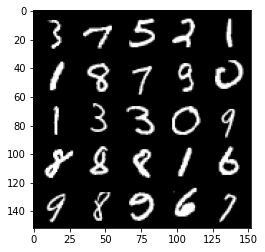

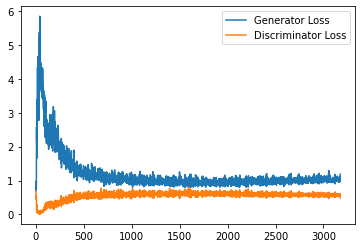

Step 64000: Generator loss: 1.044741642832756, discriminator loss: 0.5694878106713295


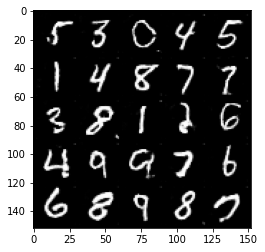

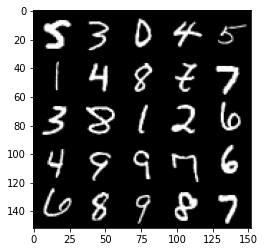

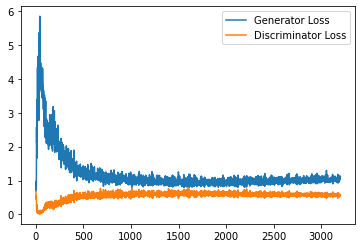

Step 64500: Generator loss: 1.0342726413011551, discriminator loss: 0.5731479232907295


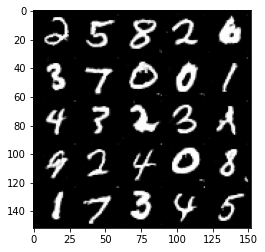

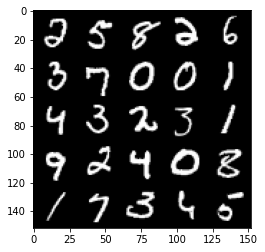

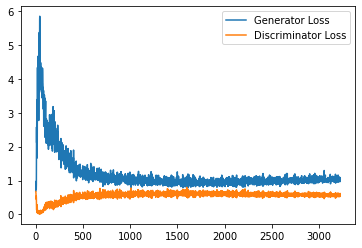

Step 65000: Generator loss: 1.0482910641431809, discriminator loss: 0.5712631381154061


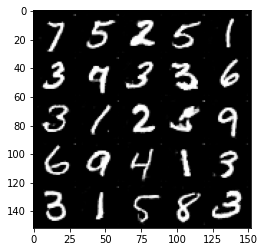

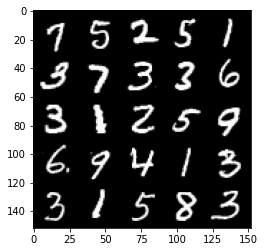

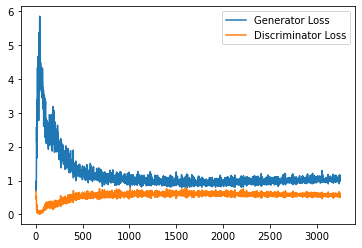

Step 65500: Generator loss: 1.0538472414016724, discriminator loss: 0.5710481412410736


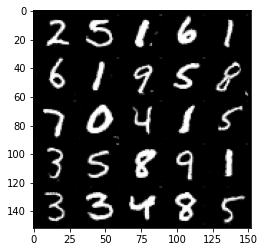

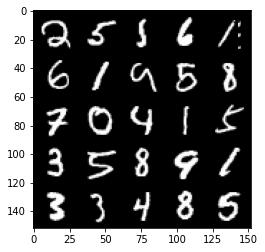

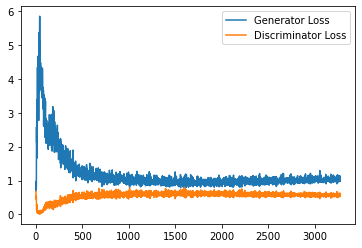

Step 66000: Generator loss: 1.051855749130249, discriminator loss: 0.5665130335688591


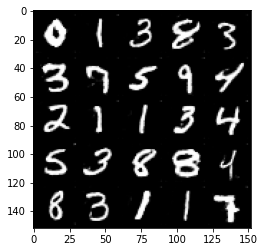

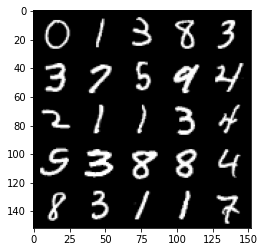

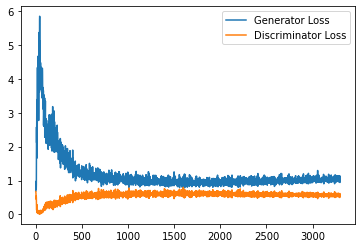

Step 66500: Generator loss: 1.05167944419384, discriminator loss: 0.5684660323262215


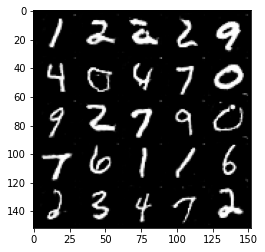

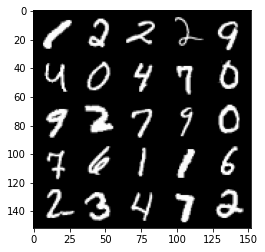

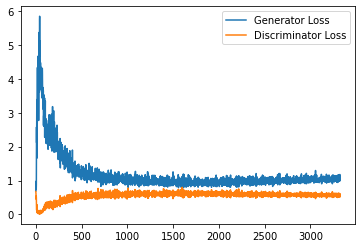

Step 67000: Generator loss: 1.0480880982875824, discriminator loss: 0.5674968137145042


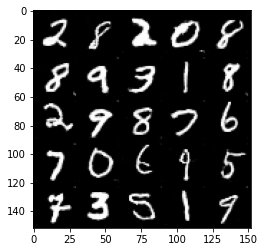

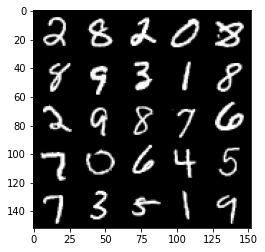

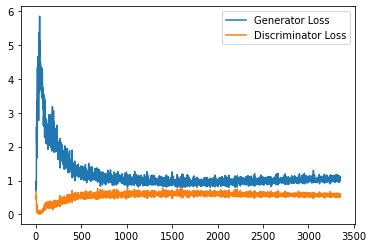

Step 67500: Generator loss: 1.0454071191549301, discriminator loss: 0.5659731995463372


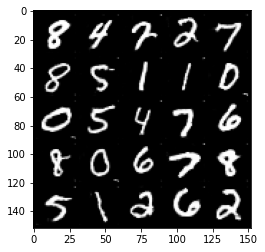

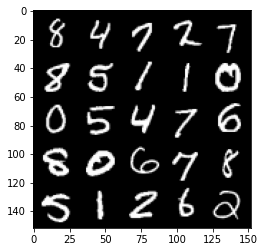

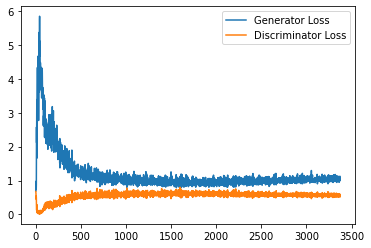

Step 68000: Generator loss: 1.0490178084373474, discriminator loss: 0.5709395842552185


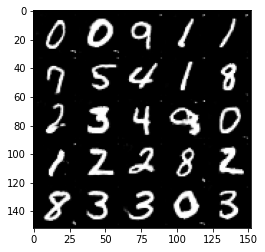

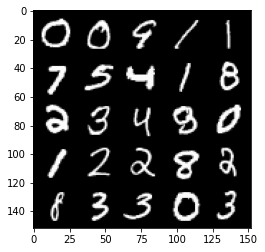

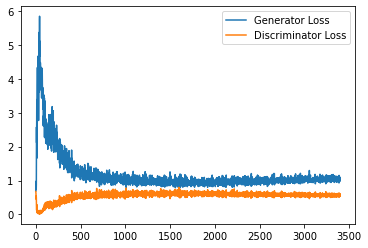

Step 68500: Generator loss: 1.048532551407814, discriminator loss: 0.5726243705749512


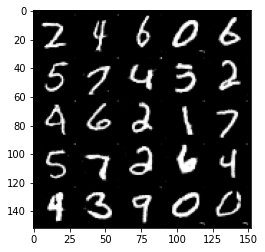

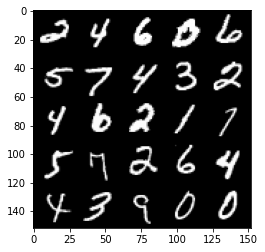

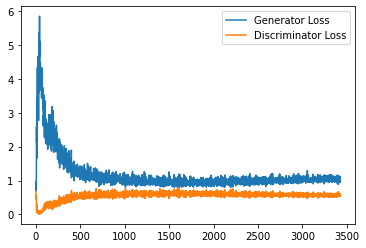

Step 69000: Generator loss: 1.0454232783317565, discriminator loss: 0.568141307592392


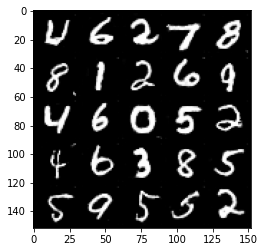

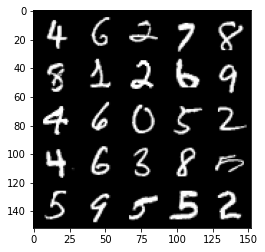

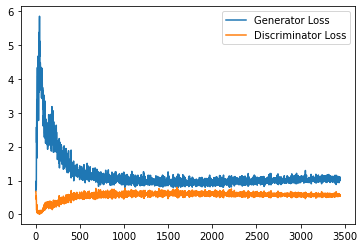

Step 69500: Generator loss: 1.0498544697761536, discriminator loss: 0.570992710351944


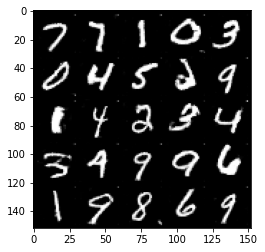

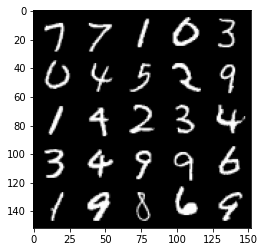

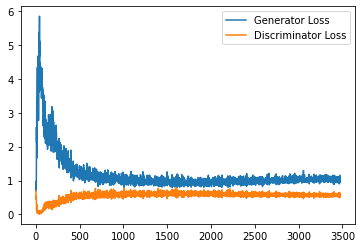

Step 70000: Generator loss: 1.0716005283594132, discriminator loss: 0.5684497497081756


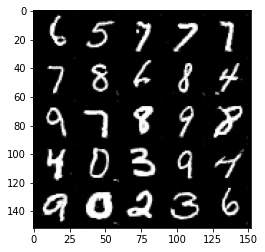

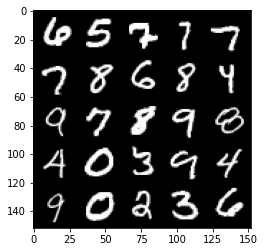

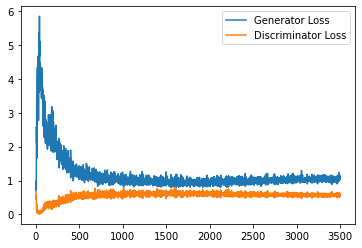

Step 70500: Generator loss: 1.040358914732933, discriminator loss: 0.5715659146308899


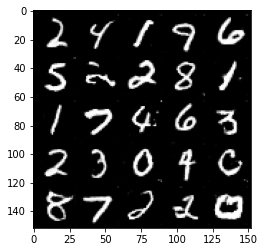

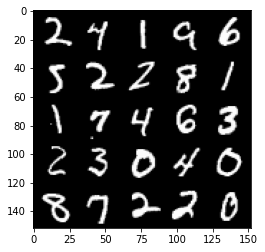

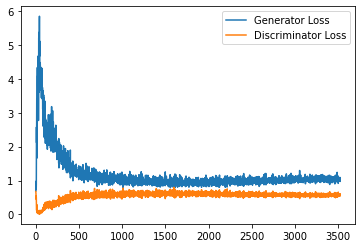

Step 71000: Generator loss: 1.0529195116758348, discriminator loss: 0.5694456498622894


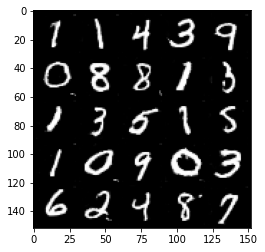

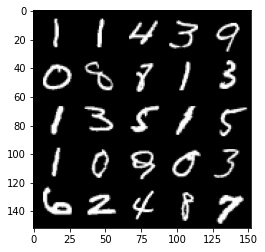

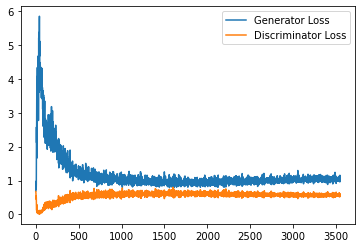

Step 71500: Generator loss: 1.0570610696077347, discriminator loss: 0.5690339567065239


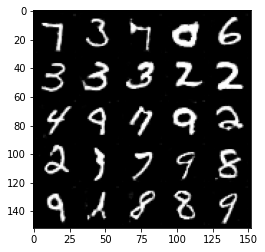

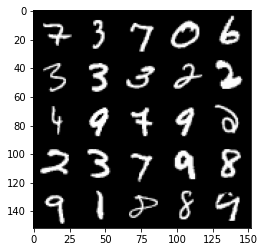

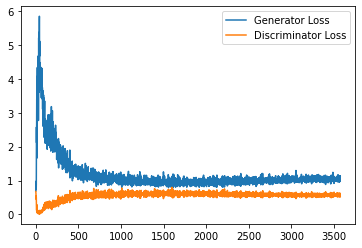

Step 72000: Generator loss: 1.0436741273403167, discriminator loss: 0.571923608481884


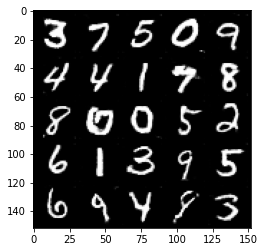

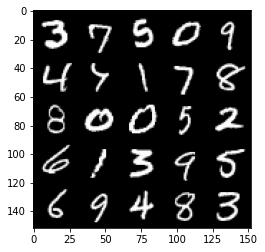

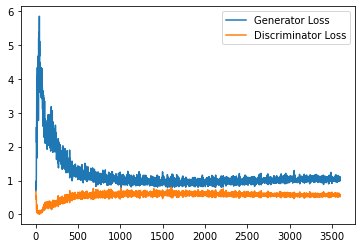

Step 72500: Generator loss: 1.053907329440117, discriminator loss: 0.5743738995790482


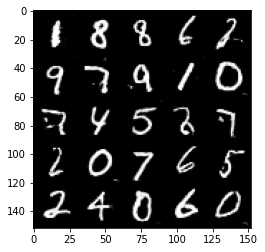

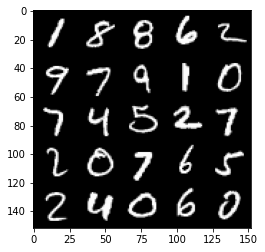

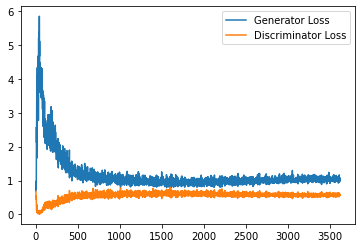

Step 73000: Generator loss: 1.0505920519828797, discriminator loss: 0.573740565419197


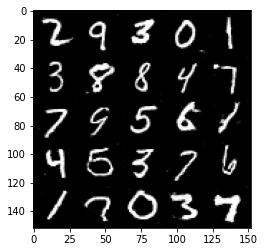

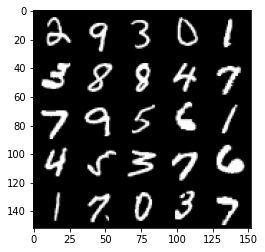

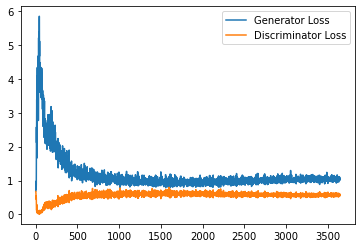

Step 73500: Generator loss: 1.051321677327156, discriminator loss: 0.5749591954350471


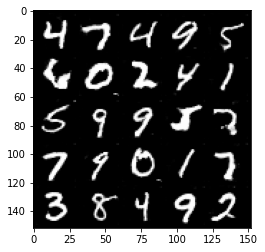

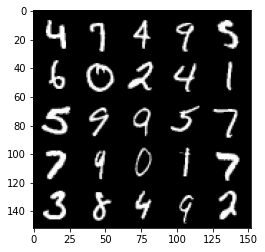

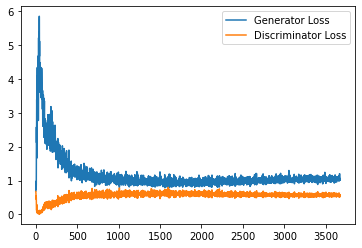

Step 74000: Generator loss: 1.043513068318367, discriminator loss: 0.5738381816744804


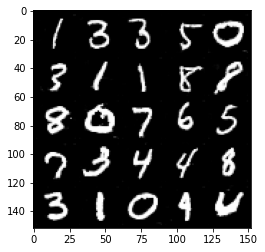

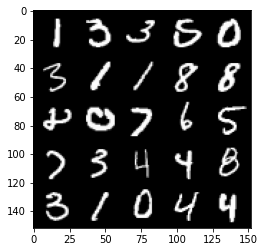

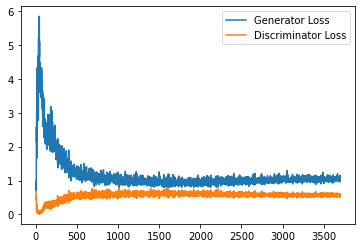

Step 74500: Generator loss: 1.0690832018852234, discriminator loss: 0.5707812936305999


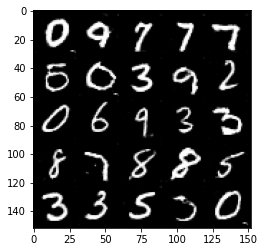

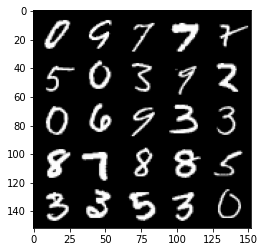

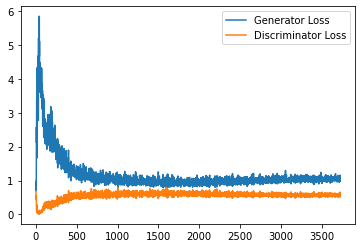

Step 75000: Generator loss: 1.0564735625982284, discriminator loss: 0.5753283007144928


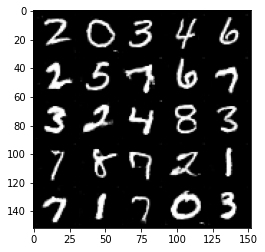

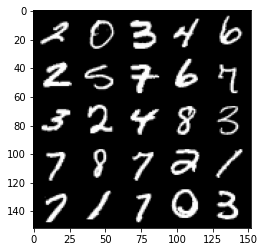

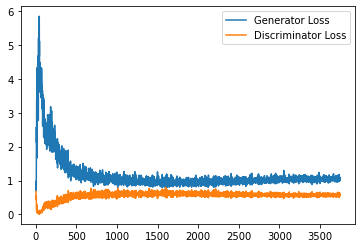

Step 75500: Generator loss: 1.0521183162927628, discriminator loss: 0.57574726998806


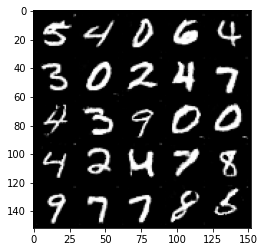

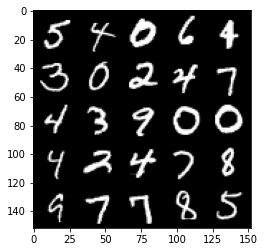

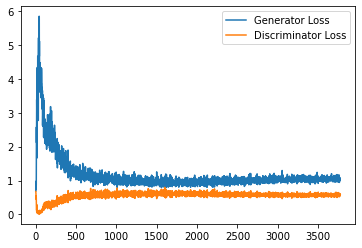

Step 76000: Generator loss: 1.0592833193540574, discriminator loss: 0.5776165191531182


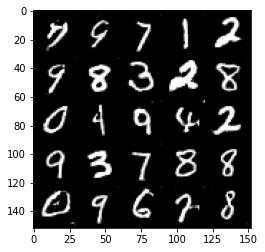

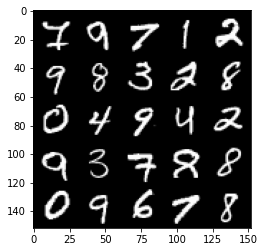

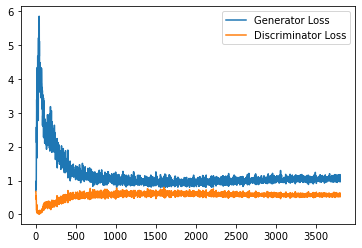

Step 76500: Generator loss: 1.0573646683692932, discriminator loss: 0.5747261181473732


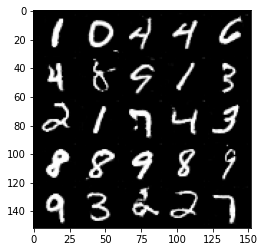

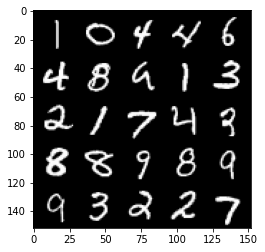

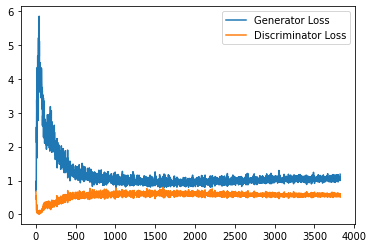

Step 77000: Generator loss: 1.0563234541416169, discriminator loss: 0.574806152164936


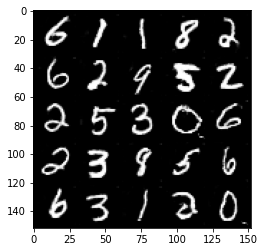

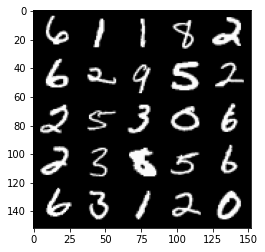

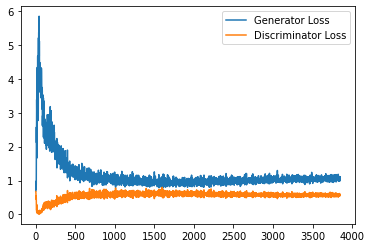

Step 77500: Generator loss: 1.0701319757699967, discriminator loss: 0.576702398777008


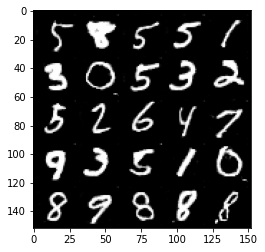

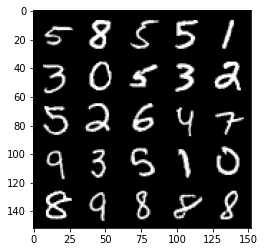

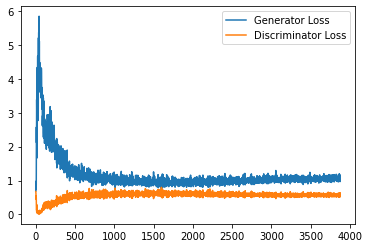

Step 78000: Generator loss: 1.057078150510788, discriminator loss: 0.5776849339604377


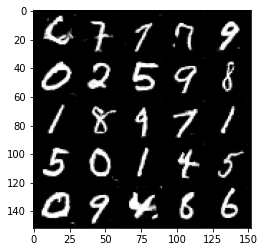

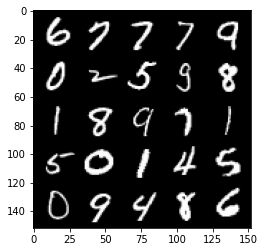

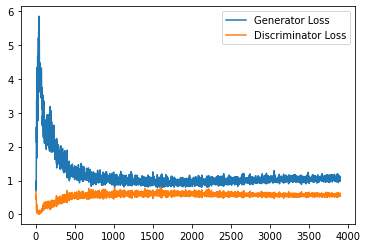

Step 78500: Generator loss: 1.0471475616693497, discriminator loss: 0.5773663954138756


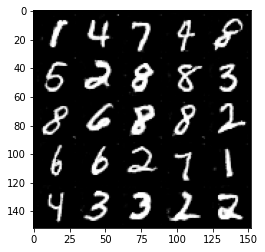

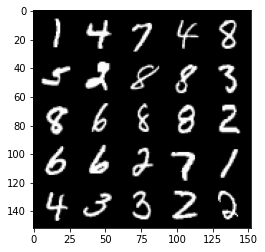

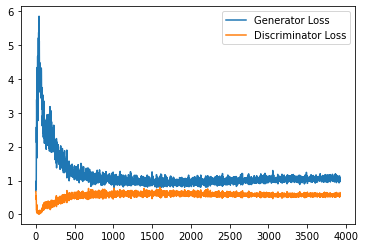

Step 79000: Generator loss: 1.0547810726165772, discriminator loss: 0.576077828347683


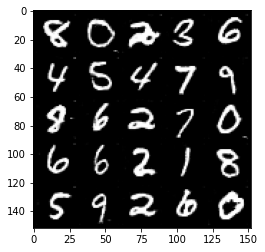

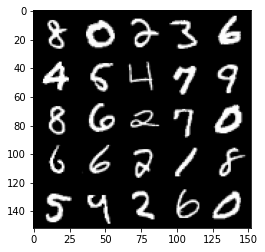

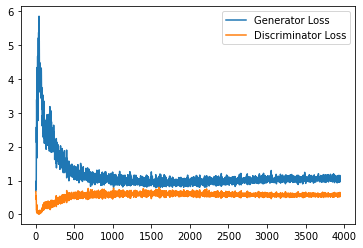

Step 79500: Generator loss: 1.0559987987279893, discriminator loss: 0.5787466649413109


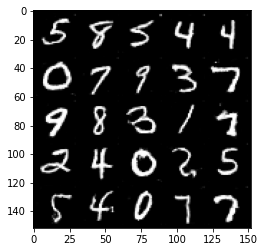

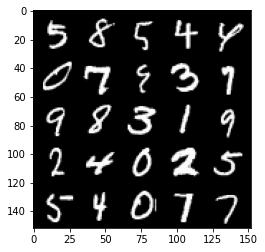

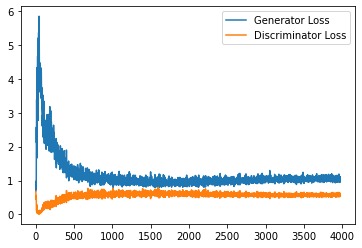

Step 80000: Generator loss: 1.0523499801158904, discriminator loss: 0.5757492635250091


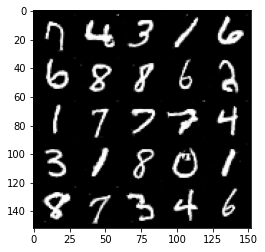

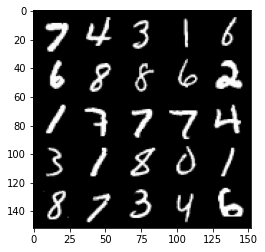

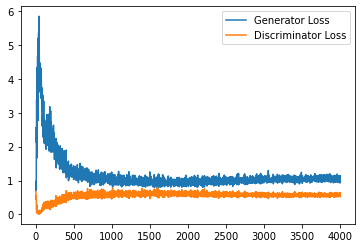

Step 80500: Generator loss: 1.0462103811502457, discriminator loss: 0.5766834937334061


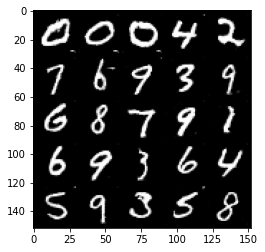

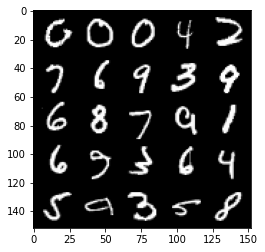

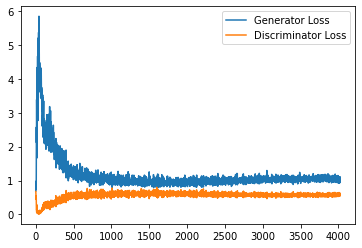

Step 81000: Generator loss: 1.0483662015199662, discriminator loss: 0.5787635678648949


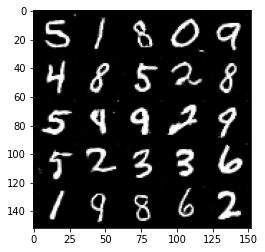

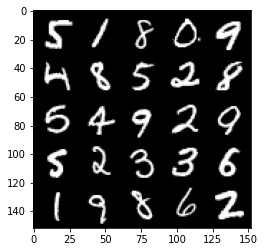

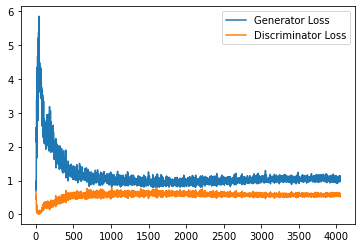

Step 81500: Generator loss: 1.0501442806720733, discriminator loss: 0.5797580866217613


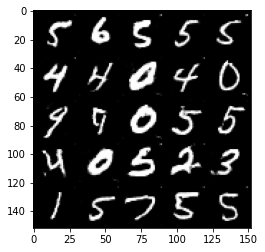

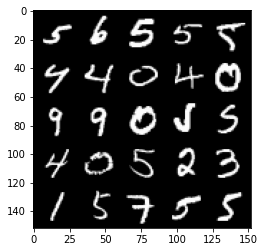

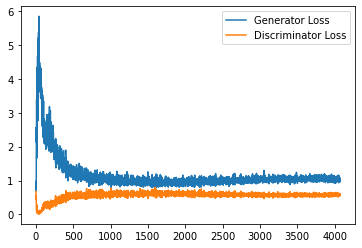

Step 82000: Generator loss: 1.0469125899076461, discriminator loss: 0.5757887051105499


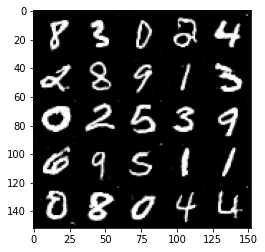

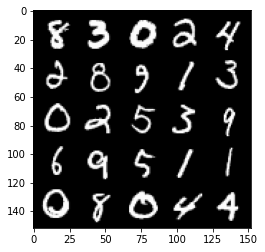

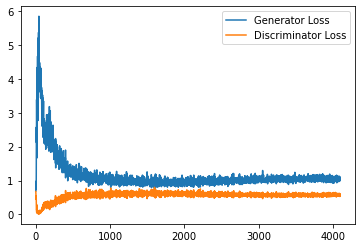

Step 82500: Generator loss: 1.0568667825460434, discriminator loss: 0.5770175753831863


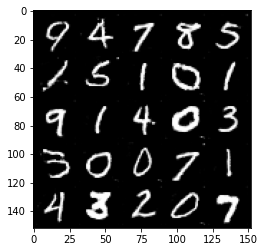

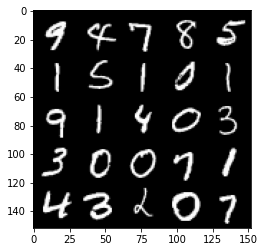

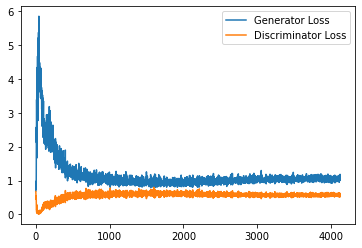

Step 83000: Generator loss: 1.0576807988882064, discriminator loss: 0.5817263030409813


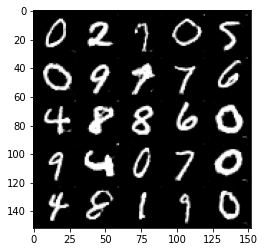

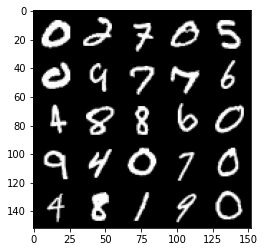

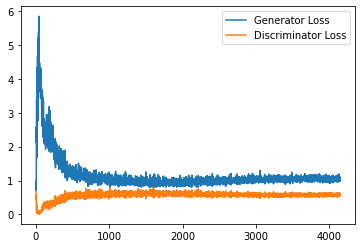

Step 83500: Generator loss: 1.0563013138771058, discriminator loss: 0.5779162021279335


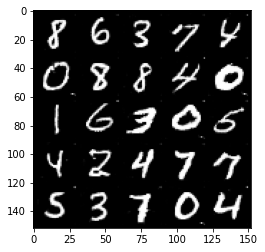

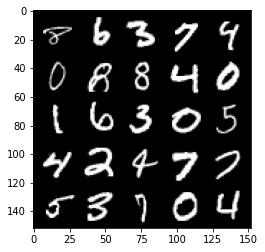

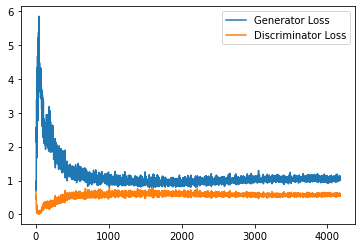

Step 84000: Generator loss: 1.0682578021287918, discriminator loss: 0.5782899785637855


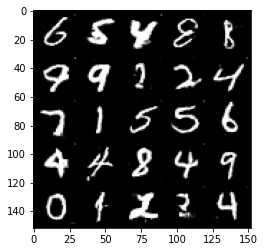

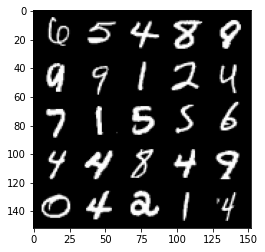

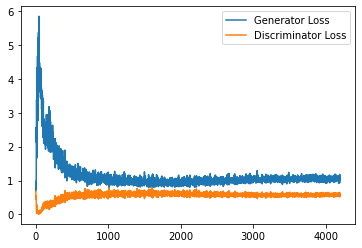

Step 84500: Generator loss: 1.0609434382915497, discriminator loss: 0.5844337170720101


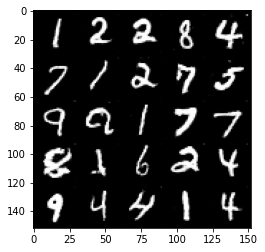

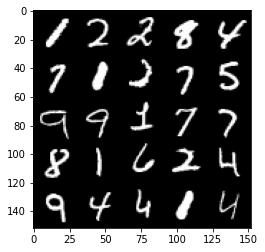

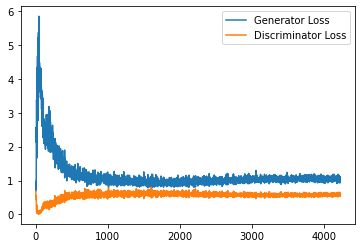

Step 85000: Generator loss: 1.0445686939954757, discriminator loss: 0.5785698330998421


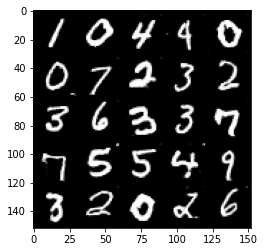

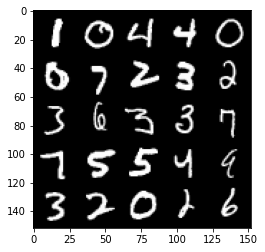

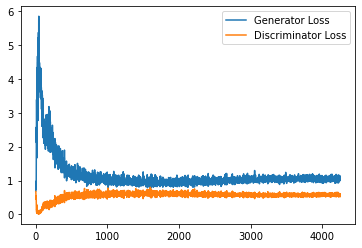

Step 85500: Generator loss: 1.0510175749063493, discriminator loss: 0.5766434916853904


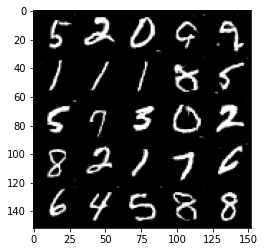

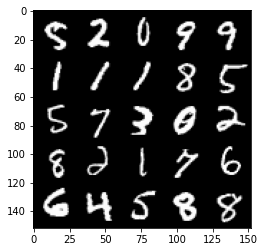

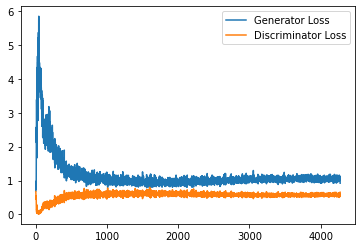

Step 86000: Generator loss: 1.067247971534729, discriminator loss: 0.5796908649802208


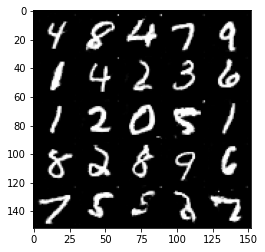

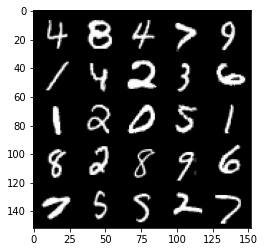

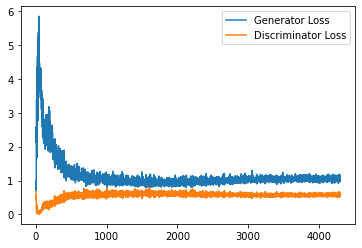

Step 86500: Generator loss: 1.060682161450386, discriminator loss: 0.5760233844518662


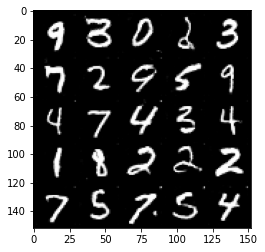

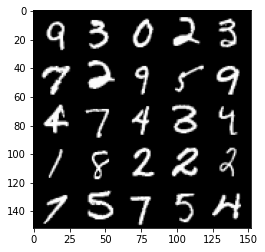

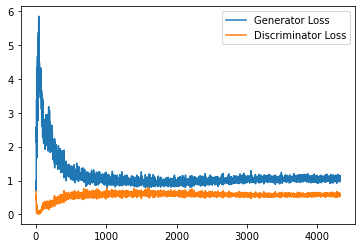

Step 87000: Generator loss: 1.048029802918434, discriminator loss: 0.5858499907255172


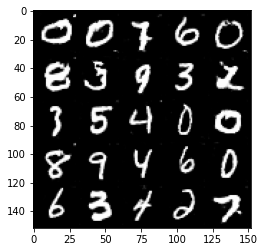

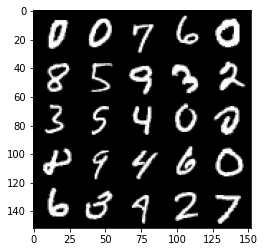

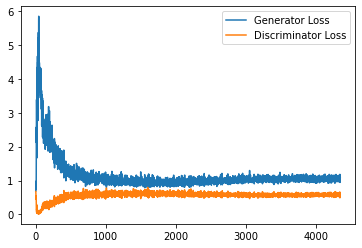

Step 87500: Generator loss: 1.0524570531845092, discriminator loss: 0.5851238398551941


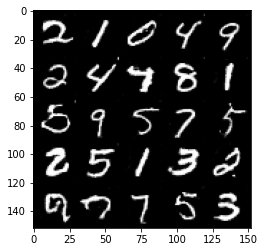

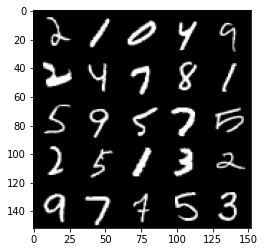

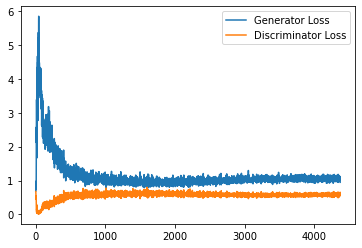

Step 88000: Generator loss: 1.0340809363126755, discriminator loss: 0.5790797941088677


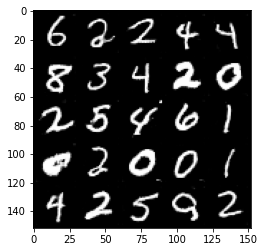

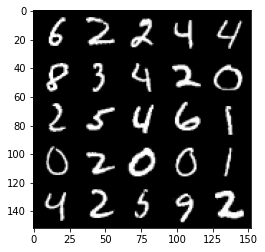

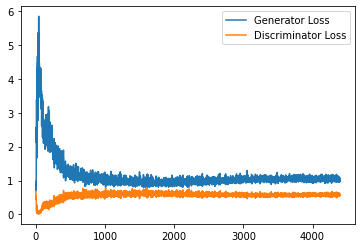

Step 88500: Generator loss: 1.042179434657097, discriminator loss: 0.5827286860942841


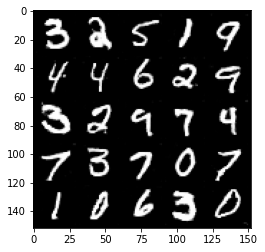

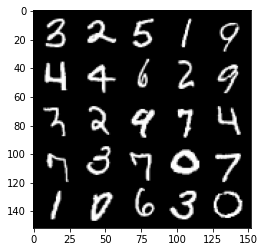

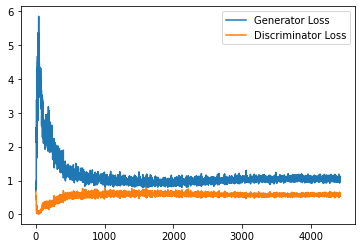

Step 89000: Generator loss: 1.0600991575717926, discriminator loss: 0.5831684248447419


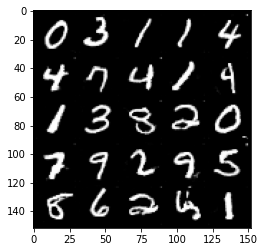

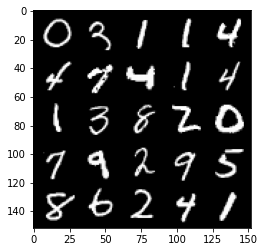

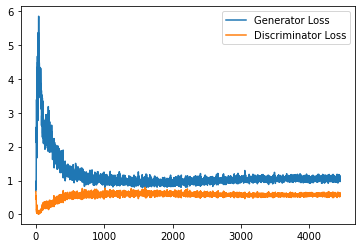

Step 89500: Generator loss: 1.0430397478342057, discriminator loss: 0.5825696913003922


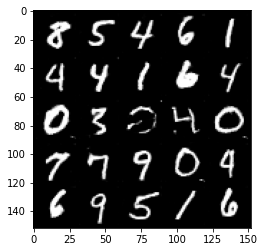

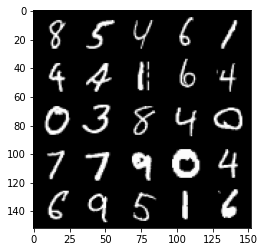

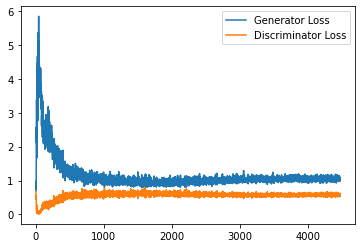

Step 90000: Generator loss: 1.043956934928894, discriminator loss: 0.5834325862526893


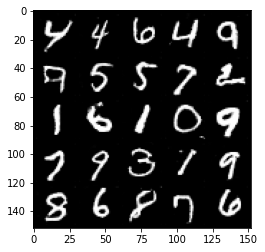

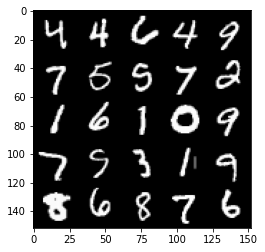

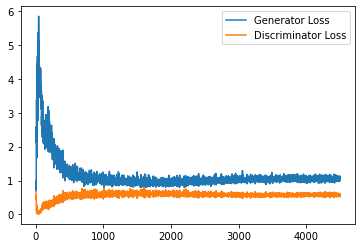

Step 90500: Generator loss: 1.0394724609851838, discriminator loss: 0.5825871339440346


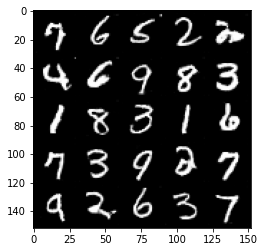

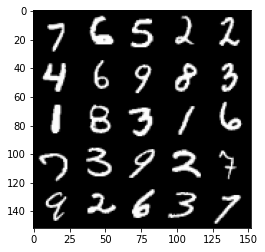

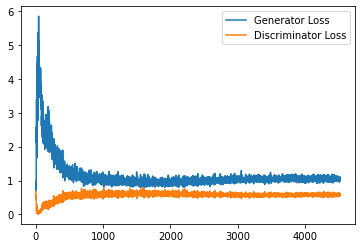

Step 91000: Generator loss: 1.0528679066896438, discriminator loss: 0.5850632073283195


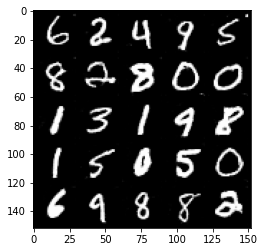

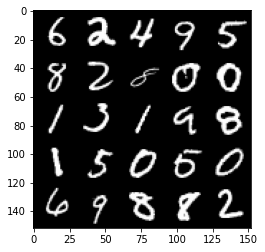

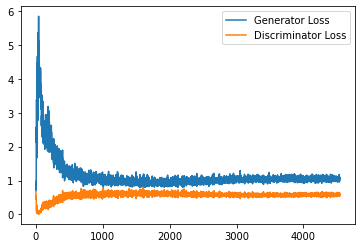

Step 91500: Generator loss: 1.0473757953643799, discriminator loss: 0.5843601206541061


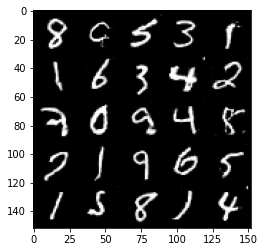

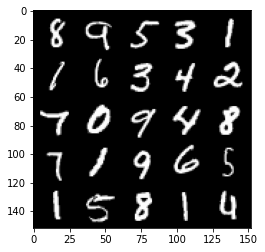

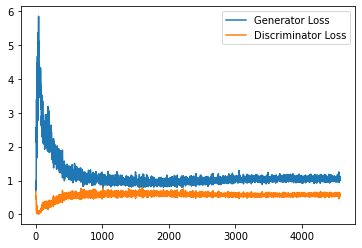

Step 92000: Generator loss: 1.0771905612945556, discriminator loss: 0.5848372560143471


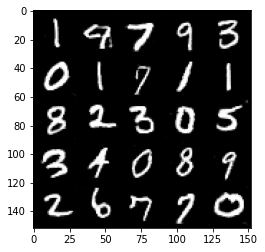

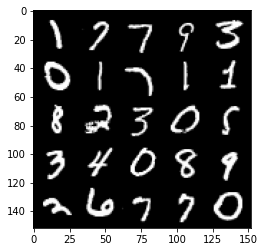

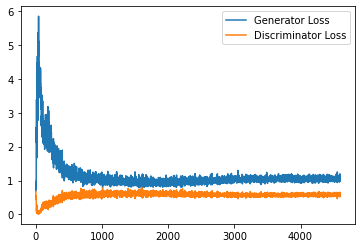

Step 92500: Generator loss: 1.0424699432849884, discriminator loss: 0.5899017973542213


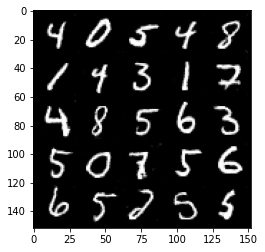

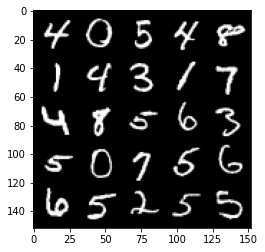

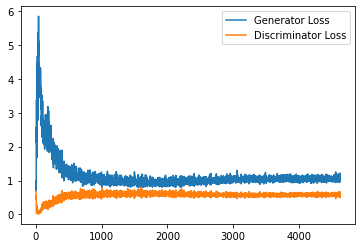

Step 93000: Generator loss: 1.0467533258199693, discriminator loss: 0.5865707234144211


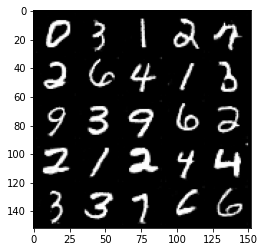

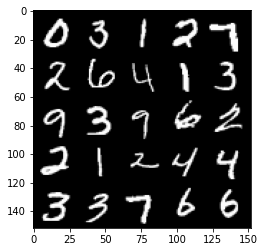

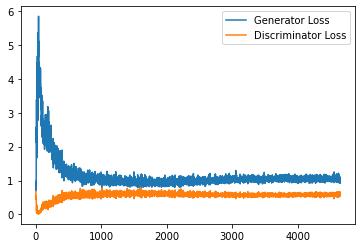

Step 93500: Generator loss: 1.0619833730459214, discriminator loss: 0.5842326608896256


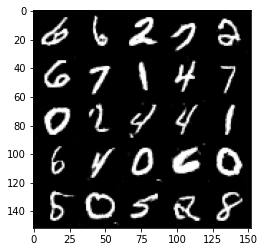

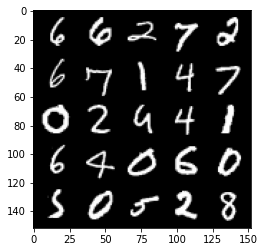

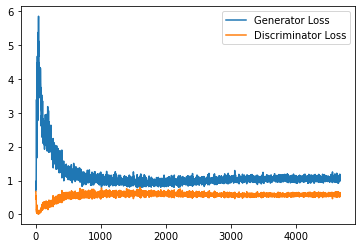

In [15]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [16]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

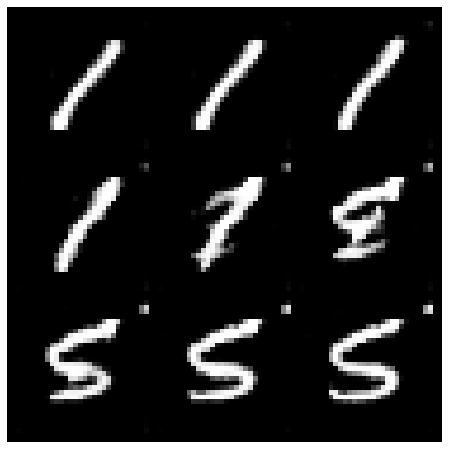

In [17]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

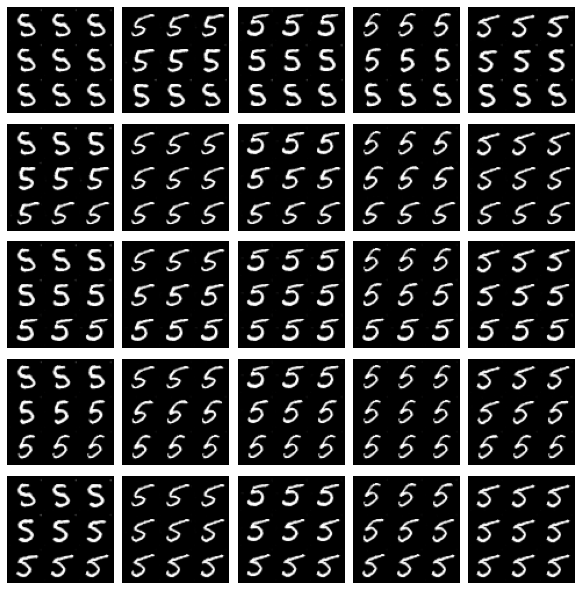

In [18]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()